In [2]:
%load_ext autoreload
%autoreload 2

import sys
import os
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import iqr
from scipy.optimize import minimize
from astropy.modeling.functional_models import Moffat2D
from astropy.coordinates import SkyCoord, EarthLocation, AltAz, ICRS
from astropy.time import Time
from astropy.timeseries import LombScargle
from astropy.wcs import WCS
from astropy import units as u
from astropy.io import fits
from astropy import constants
from astropy.modeling.models import BlackBody
from astropy.visualization import quantity_support
from tqdm import tqdm


In [3]:
#Move up to RAFTS directory
if os.getcwd().endswith('/RAFTS'):
    pass
else:
    os.chdir('../../')

In [4]:
pwd

'/Users/fbianco/RAFTS'

In [5]:
!pip install photutils


[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: pip install --upgrade pip


In [6]:
%load_ext autoreload
%autoreload 2

from photutils.psf import IntegratedGaussianPRF, PSFPhotometry, ImagePSF, MoffatPSF, CircularGaussianPRF, CircularGaussianPSF, GaussianPSF, GaussianPRF, CircularGaussianSigmaPRF
from photutils.detection import DAOStarFinder
from photutils.aperture import CircularAperture
from photutils.background import MMMBackground, LocalBackground

import astrometry_and_photometry as defs

from utils import filt_interp, dpar, dtan, lamb_eff_md, dcr_offset, celest_to_pa, inverse_Teff, inverseTeff, inverseWeff, lorentzian, chrDistAng
import globals


from config import *


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [7]:
#PARAMS
flare_ref_pos = np.array([322.0, 428.5])
match_dist = 0.5
fit_shape = (25, 25)

In [8]:
imnames = np.array(os.listdir('dwfflare/dwfflareS18/'))
imnames = np.array([i for i in imnames if i.endswith("fits.fz") or i.endswith("fits")])

len(imnames)

74

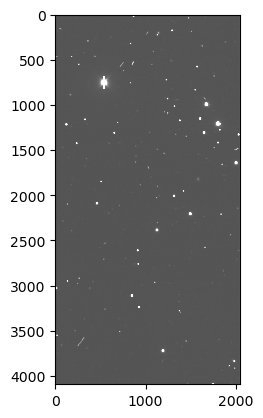

In [9]:
image_header = fits.getheader('dwfflare/dwfflareS18/' + "bb80830e498d95fbf625ab55364d769a_c4d_151218_064526_ooi_g_v1_S18.fits.fz")
data = fits.getdata(ROOTDIR + 'dwfflare/dwfflareS18/' + "bb80830e498d95fbf625ab55364d769a_c4d_151218_064526_ooi_g_v1_S18.fits.fz")
plt.imshow(data, cmap='Greys_r', clim=(0,100))


In [10]:
#sorting images by time

#Collect DATE-OBS list
datelist = []

for i, imname in enumerate(imnames):
    image_header = fits.getheader('dwfflare/dwfflareS18/' + imname)
    datelist.append(image_header['DATE-OBS'])

    

datearr = np.array(datelist)
len(datearr), len(datelist)

imnames_timeordered = imnames[np.argsort(datearr)]
np.save('Outdata/imnames_timeordered.npy', imnames_timeordered)

In [11]:
!pwd

/Users/fbianco/RAFTS


Img 0


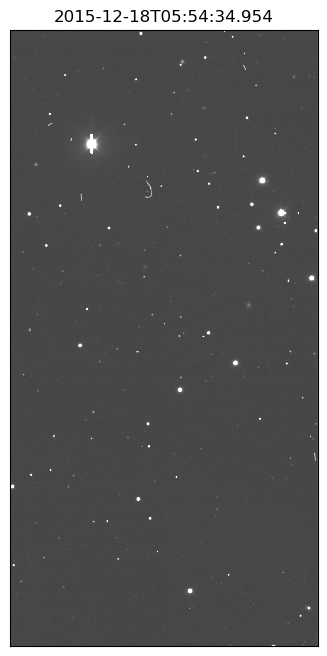

Img 1


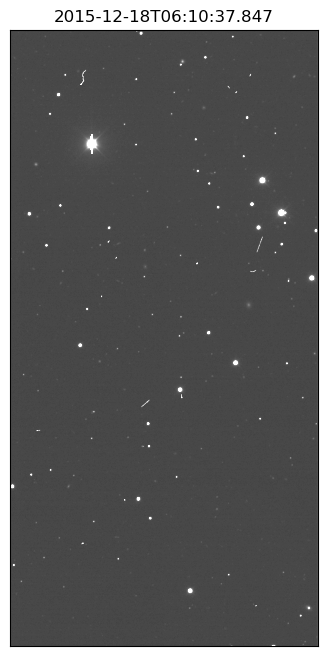

Img 2


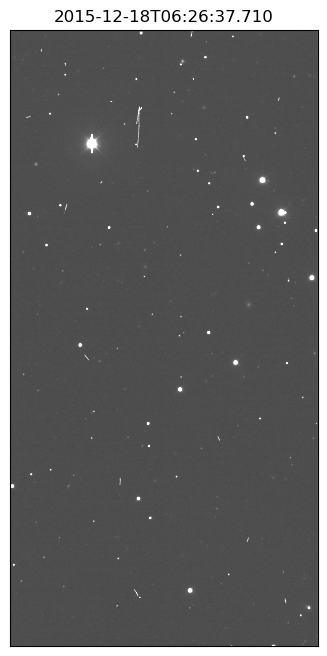

In [12]:
#Look at first 10 imgs
for i, imname in enumerate(imnames_timeordered[10:60:20]):
    file = 'dwfflare/dwfflareS18/' + imname 
    data = fits.getdata(ROOTDIR + 'dwfflare/dwfflareS18/' + imname)
    header = fits.getheader(ROOTDIR + 'dwfflare/dwfflareS18/' + imname)
    wcs = WCS(header)
    time = Time(header['DATE-OBS'])

    print('Img {}'.format(i))
    plt.figure(figsize=(16,8))
    plt.imshow(data, cmap='Greys_r', clim=(0,100))
    plt.title('{}'.format(time))
    plt.xticks([])
    plt.yticks([])
    plt.show()

# Check we understand the sky orientation

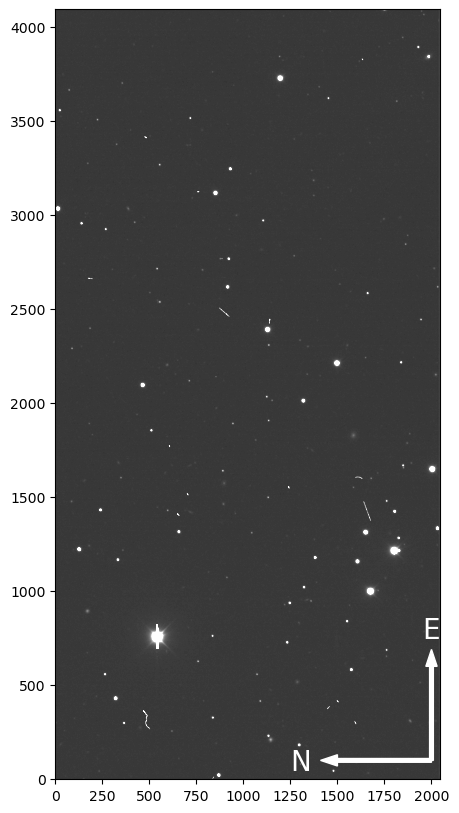

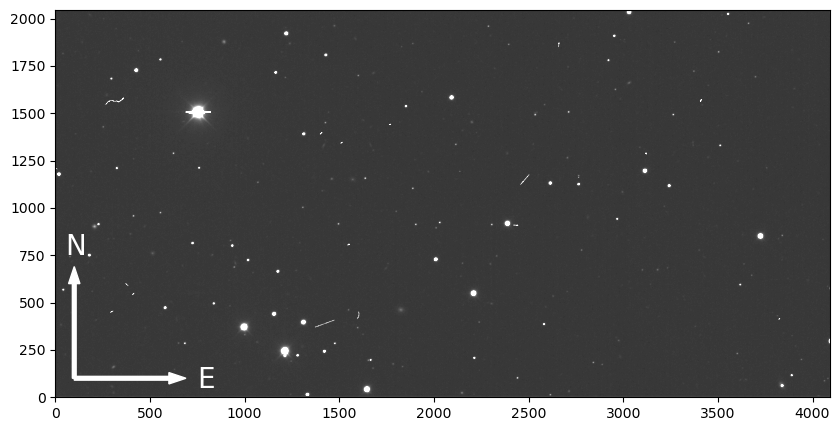

In [13]:
from scipy.ndimage import rotate

name = '489f990fd94eb9cff4b14219e98b6bde_c4d_151218_061146_ooi_g_v1_S18.fits.fz'
file = ROOTDIR + '/dwfflare/dwfflareS18/' + name

flare_data = fits.getdata(ROOTDIR + '/dwfflare/dwfflareS18/' + name)
flare_header = fits.getheader(ROOTDIR + '/dwfflare/dwfflareS18/' + name)

fig = plt.figure(figsize=(10,10))
ax = plt.subplot()
ax.imshow(rotate(flare_data, angle=0), cmap='gray', clim=(0,100), origin='lower')
ax.arrow(x=2000, y=100, dx=0, dy=500, color='white', width=20)
ax.annotate("E", xy=(1950, 750), c='white', fontsize=20)

ax.arrow(x=2000, y=100, dx=-500, dy=0, color='white', width=20)
ax.annotate("N", xy=(1250, 50), c='white', fontsize=20)
fig.show()

fig = plt.figure(figsize=(10,10))
ax = plt.subplot()
ax.imshow(rotate(flare_data, angle=90), cmap='gray', clim=(0,100), origin='lower')
ax.arrow(x=100, y=100, dx=0, dy=500, color='white', width=20)
ax.annotate("N", xy=(50, 750), c='white', fontsize=20)

ax.arrow(x=100, y=100, dx=500, dy=0, color='white', width=20)
ax.annotate("E", xy=(750, 50), c='white', fontsize=20)
fig.show()

## PSF Fitting

## Find stars in one image
**Important**: the hyperparameters chose in this DAOStarFinder run determin the numbering of sources. The rest of the analysis will assume that the ID of the flare star is 11, according to the star chart produced here. If this cell of code is modified (e.g. choosing a different reference image or chaning the DAOStarFinder argument values)  the user shoudl change the variable flare_ID in config.py


4.933661


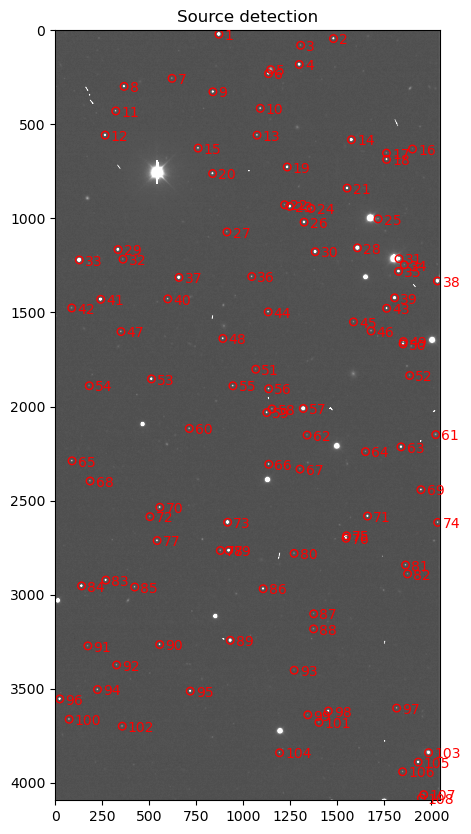

2015-12-18T06:33:52.769


In [14]:

imname = imnames[7]
file = 'dwfflare/dwfflareS18/' + imname 
data = fits.getdata('dwfflare/dwfflareS18/' + imname)
header = fits.getheader('dwfflare/dwfflareS18/' + imname)
print(header['FWHM'])
wcs = WCS(header)
time = Time(header['DATE-OBS'])

mmm_bkg = MMMBackground()
localbkg_estimator = LocalBackground(5, 10, mmm_bkg)

finder = DAOStarFinder(threshold=1*mmm_bkg(data), fwhm=header['FWHM'], 
                       roundlo=-0.5, roundhi=0.5, peakmax=10_000, exclude_border=True)
sources = finder(data)

positions = np.transpose((sources['xcentroid'], sources['ycentroid']))

xycoords = positions #we keep this as the golden list of stars for photometry
apertures = CircularAperture(positions, r=20.)

plt.figure(figsize=(20,10))
plt.imshow(data, clim=(0,100), cmap='Greys_r')
apertures.plot(color='red')

for i, p in enumerate(positions):
    plt.annotate('{0}'.format(sources['id'][i]), xy=p, xytext=p+30, color='r')
plt.title('Source detection')
plt.show()

psf_model = IntegratedGaussianPRF(sigma=header['FWHM'])
fit_shape = (25, 25)
psfphot = PSFPhotometry(psf_model, fit_shape, finder=finder, aperture_radius=5,
                        localbkg_estimator=localbkg_estimator)
phot = psfphot(data)
print(time)

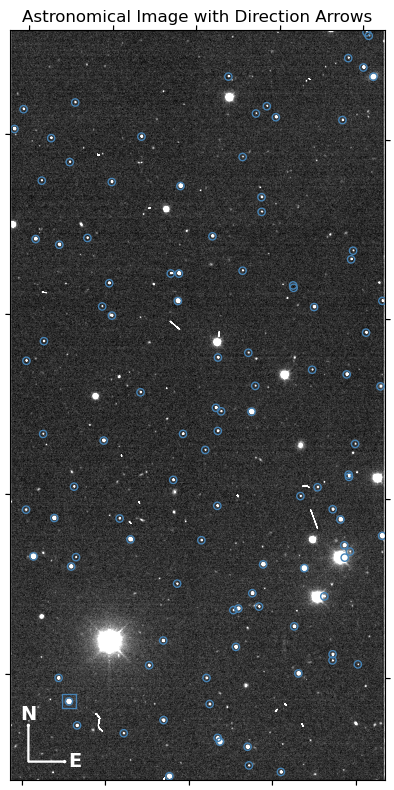

In [15]:
# Create the plot with WCS projection

import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import astropy.units as u
from matplotlib.patches import FancyArrowPatch

header = flare_header
# Get WCS information
wcs = WCS(header)

# Create the plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection=wcs)

# Display the image
vmin = np.percentile(data, 5)
vmax = np.percentile(data, 95)
ax.imshow(flare_data, origin='lower', cmap='gray', vmin=vmin, vmax=vmax)

# Add north and east arrows
# Get the center of the image in pixel coordinates

# Arrow properties
arrow_length = min(flare_data.shape) * 0.1  # 10% of smaller dimension
arrow_color = 'w'
arrow_width = 5
head_width = 15
head_length = 8

# North arrow (pointing up)
ax.arrow(100, 100, 0, arrow_length, 
         color=arrow_color, width=arrow_width, 
         head_width=head_width, head_length=head_length,
         length_includes_head=True)

# East arrow (pointing right)
ax.arrow(100, 100, arrow_length, 0, 
         color=arrow_color, width=arrow_width, 
         head_width=head_width, head_length=head_length,
         length_includes_head=True)

# Add labels
ax.text(100, 100 + arrow_length + 50, 'N', 
        color=arrow_color, fontsize=14, fontweight='bold',
        ha='center', va='center')
ax.text(100 + arrow_length + 50, 100, 'E', 
        color=arrow_color, fontsize=14, fontweight='bold',
        ha='center', va='center')

# Set labels
ax.set_xlabel('RA')
ax.set_ylabel('Dec')
ax.set_title('Astronomical Image with Direction Arrows')
plt.scatter(flare_ref_pos[0], flare_ref_pos[1], marker='s', s=100, edgecolors='SteelBlue', facecolors='None')
    
plt.tight_layout()

apertures_rotated = CircularAperture(positions, r=20)
apertures_rotated.plot(color='SteelBlue')

fig.show()

## testing Empirical PSF model

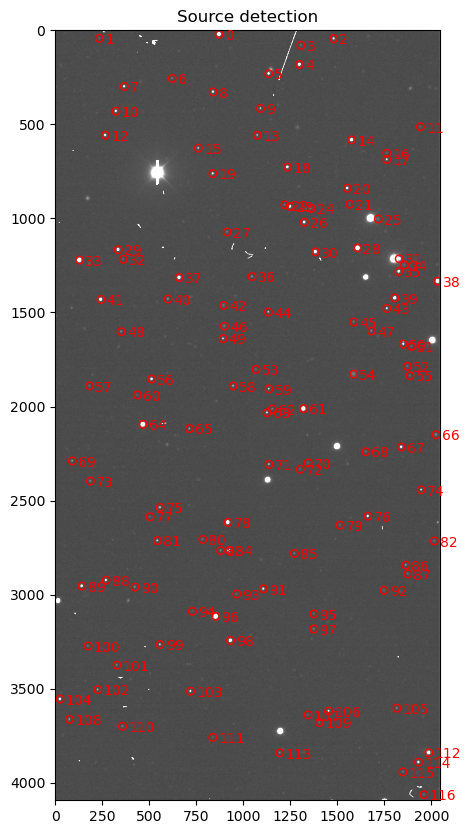

<Figure size 640x480 with 0 Axes>

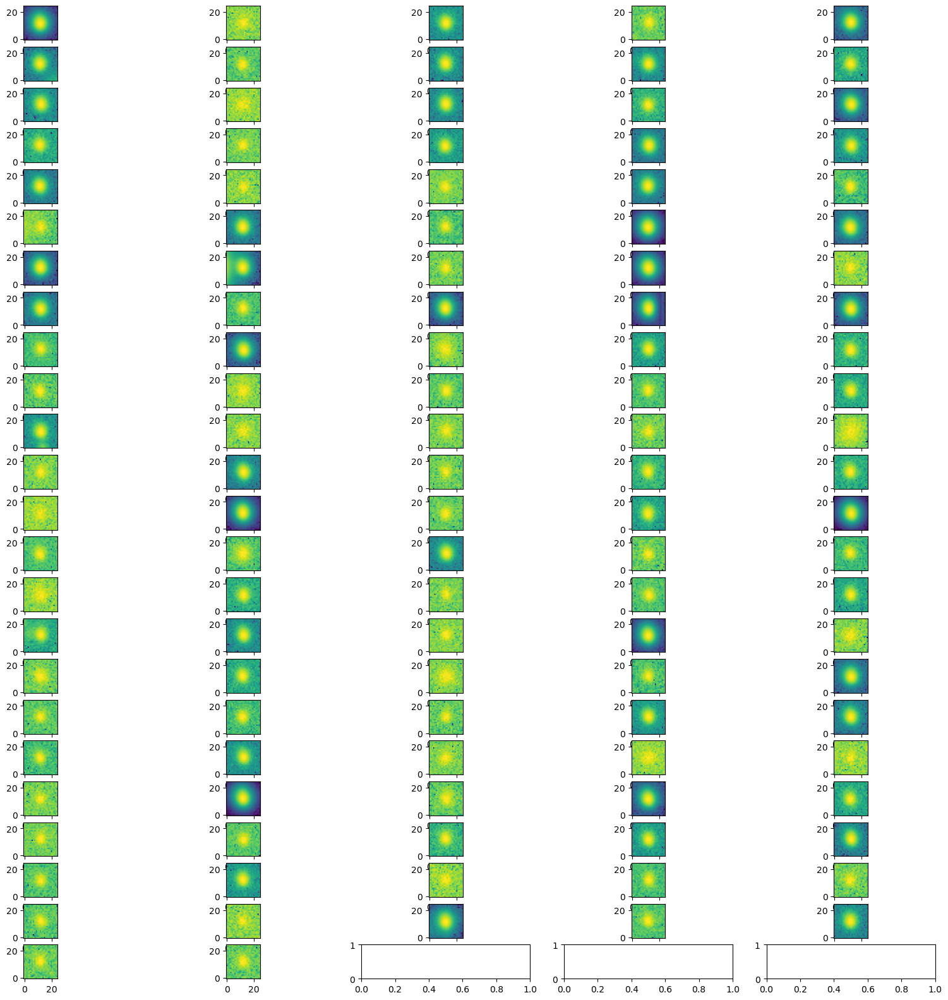

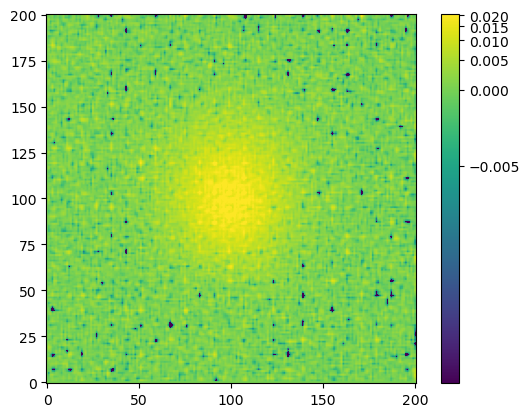

In [16]:
imname = imnames_timeordered[40]
oversampling = 8
file = 'dwfflare/dwfflareS18/' + imname 
data = fits.getdata('dwfflare/dwfflareS18/' + imname)
header = fits.getheader('dwfflare/dwfflareS18/' + imname)
wcs = WCS(header)
time = Time(header['DATE-OBS'])
epsf_model = defs.makefitpsf(data, header, fit_shape, oversampling=oversampling, plot=True)

### which function fits our PSF based on image 40? Gaussian or Moffat

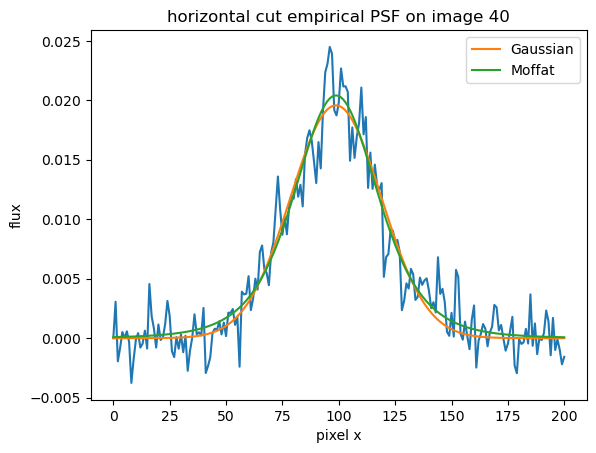

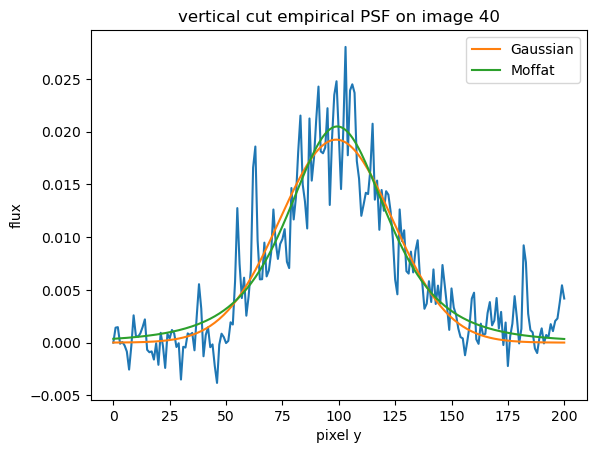

In [17]:

assert fit_shape[0]==fit_shape[1], "fit shape for epsf model not square - not sure what to do"

imgsize = fit_shape[0] * oversampling

def dg(pars, x, truth):
    return ((g(pars, x) - truth)**2).sum()
def dm(pars, x, truth):
    return ((mf(pars, x) - truth)**2).sum()

def g(pars, x):
    mu, sig, a = pars
    return np.exp(-(x-mu)**2/2/sig**2)/a
def mf(pars, x):
    amplitude, mux, gamma, alpha = pars
    return Moffat2D.evaluate(x, imgsize // 2, amplitude=amplitude, x_0=mux, y_0=imgsize // 2, gamma=gamma, alpha=alpha)

x = np.arange(imgsize + 1)

truth = epsf_model.data[imgsize // 2,:]
plt.plot(truth)
pars0 = imgsize // 2, 25, 25
pars = minimize(dg, pars0, args=(x, truth)).x
plt.plot(g(pars, x), label="Gaussian")

pars0 = 0.022, imgsize // 2, 22, 1
pars = minimize(dm, pars0, args=(x, truth)).x
plt.plot(mf(pars, x), label="Moffat")
plt.title("horizontal cut empirical PSF on image 40")
plt.ylabel("flux")
plt.xlabel("pixel x")
plt.legend()
plt.show()

truth = epsf_model.data[:,imgsize // 2]
plt.plot(truth)
pars0 = imgsize // 2, 25, 25
pars = minimize(dg, pars0, args=(x, truth)).x
plt.plot(g(pars, x), label="Gaussian")
plt.title("vertical cut empirical PSF on image 40")
pars0 = 0.022, imgsize // 2, 22, 1
pars = minimize(dm, pars0, args=(x, truth)).x
plt.plot(mf(pars, x), label="Moffat")
plt.ylabel("flux")
plt.xlabel("pixel y")
plt.legend()
plt.show()

## CONCLUSION: The empirical PSF is not significantly different from either a Moffat or a Gaussian, given that it's quite noisy. However, it is not symmetric enough to justify a circular PSF

## PSF Fitting Across Multiple Images

In [18]:
print(f"Nimages: {end - start}")

Nimages: 74


### hyperparameter for PSF fitting

In [19]:
threshold = 1
fwhm = 2
roundlo = -0.5
roundhi = 0.5
peakmax = 10_000
minsep = 5
imgsize = 500
step = 1

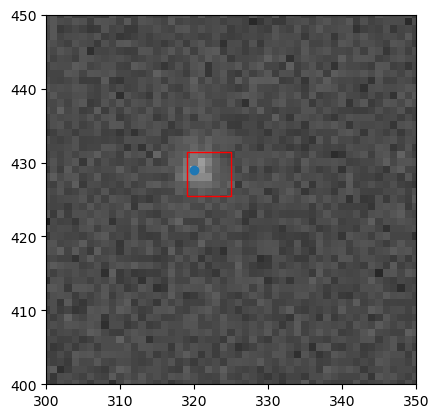

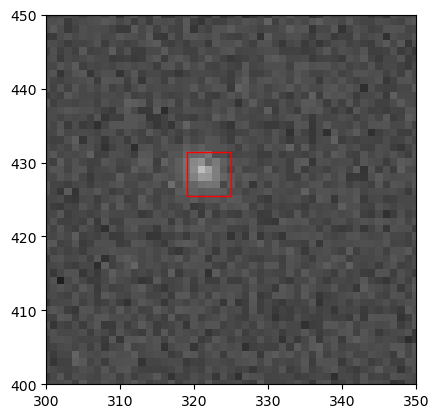

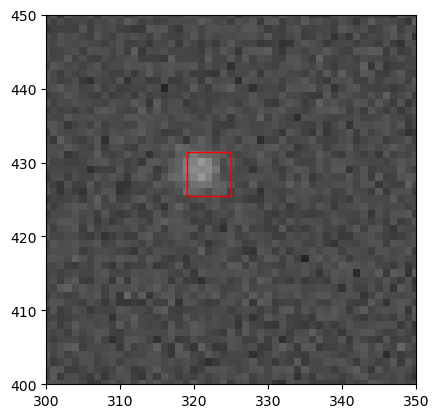

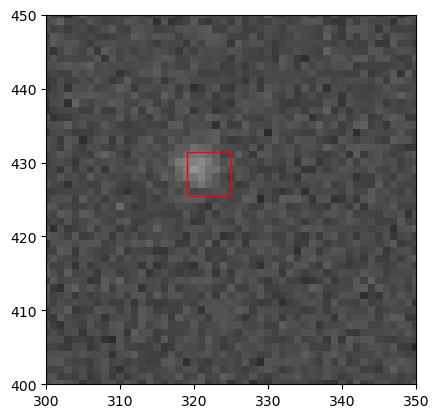

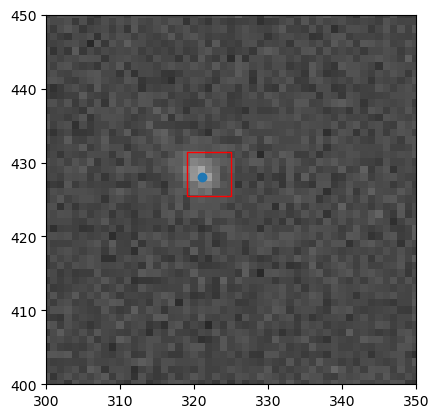

...

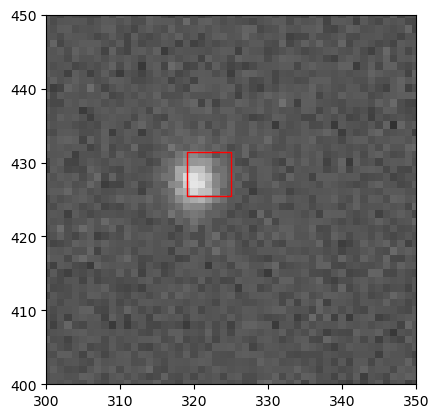

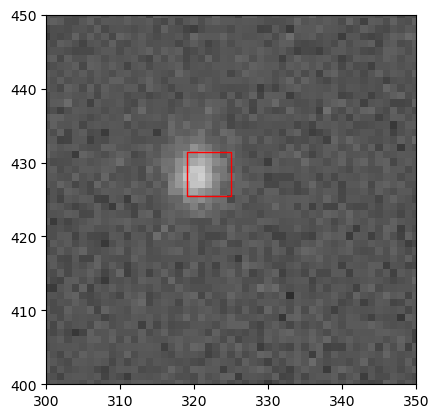

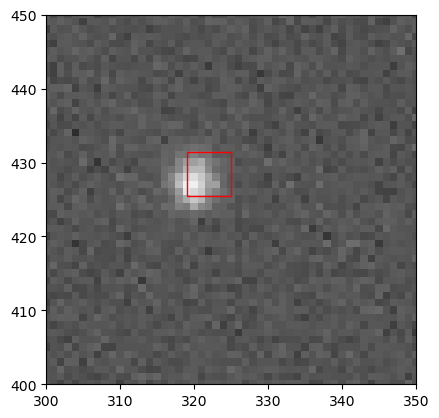

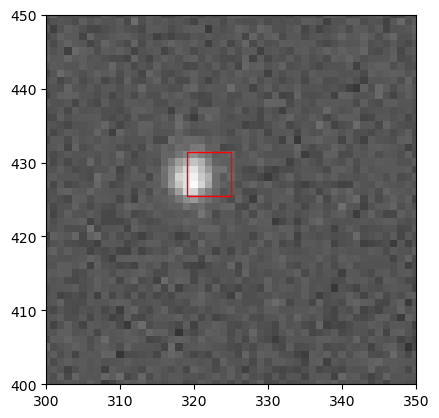

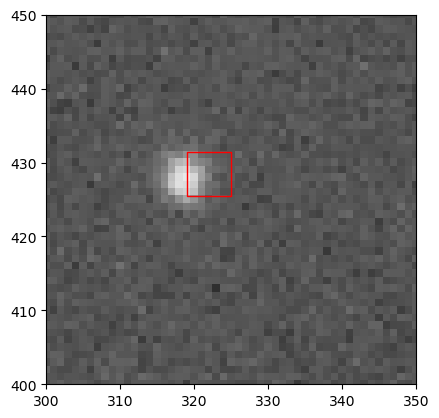

In [20]:
for i,img in enumerate(imnames_timeordered):
    data = fits.getdata('dwfflare/dwfflareS18/' + img)
    header = fits.getheader('dwfflare/dwfflareS18/' + img)
    plt.imshow(data[:imgsize,:imgsize], clim=(0,100), cmap='Greys_r')
    plt.scatter(flare_ref_pos[0], flare_ref_pos[1], marker='s', s=1_000, edgecolors='r', facecolors='None')
    if i == 0:
        plt.scatter(320,429)
    elif i==4 or i==5:
        plt.scatter(321,428)

    plt.xlim(300,350)
    plt.ylim(400,450)
    plt.show()

0
Background: 22.61159896850586
Seeing: 1.169462034 arcsec
nsources detected 92
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 92
1
Background: 22.213088989257812
Seeing: 1.1767570308 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 320.8394015601286 428.5117224803095
matchescount 91, [0, 1]
celest finder chart, black photometry output, blue matched output


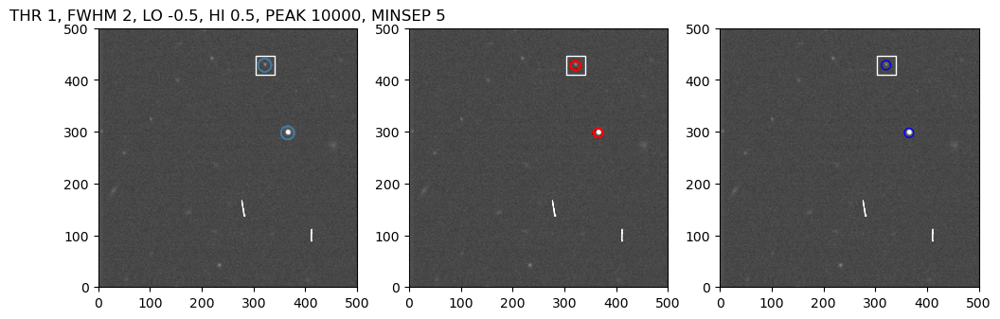

2
Background: 21.96426773071289
Seeing: 1.227742371 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 320.92904407383304 428.2177301969652
matchescount 91, [0, 1, 1]
celest finder chart, black photometry output, blue matched output


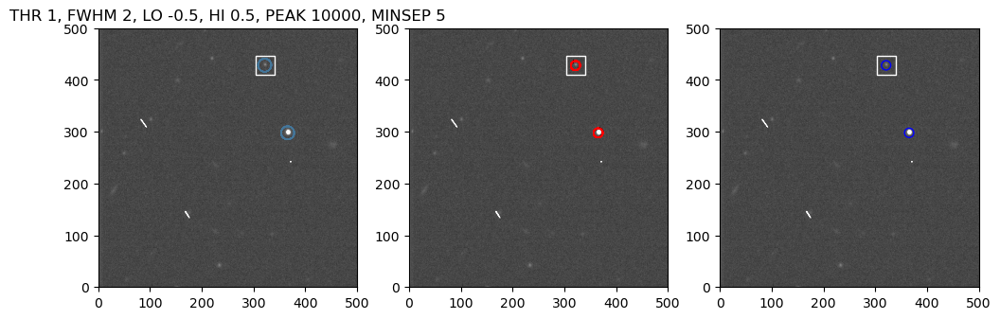

([1.169462034, 1.1767570308, 1.227742371],
 [92, 92, 105, 105, 105, 105],
 [0, 91, 91],
 [0, 1, 1],
 [0, 1, 0, 1, 0, 1],
 [22.61159896850586, 22.213088989257812, 21.96426773071289])

In [21]:
#test on problematic images
imgs = np.hstack([imnames_timeordered[start:start+1], imnames_timeordered[start+4:start+6]])
defs.psffittests(IntegratedGaussianPRF(sigma=header['FWHM']/2.355), threshold, fwhm, roundlo, roundhi, 
                 peakmax, minsep, imgs, xycoords, flare_ref_pos, plot=True, report=True)
                                                                                                

0
Background: 22.61159896850586
Seeing: 1.169462034 arcsec
nsources detected 92
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 92
1
Background: 22.213088989257812
Seeing: 1.1767570308 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 320.81334165731244 428.5929536537775
matchescount 89, [0, 1]
celest finder chart, black photometry output, blue matched output


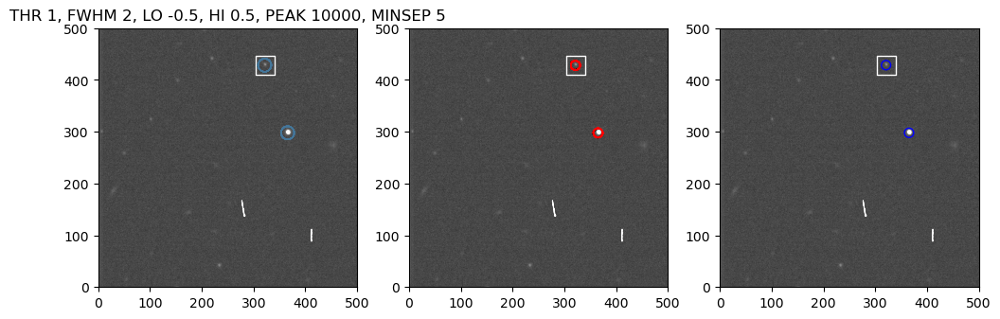

2
Background: 21.96426773071289
Seeing: 1.227742371 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 320.8256461098175 428.42800205848255
matchescount 89, [0, 1, 1]
celest finder chart, black photometry output, blue matched output


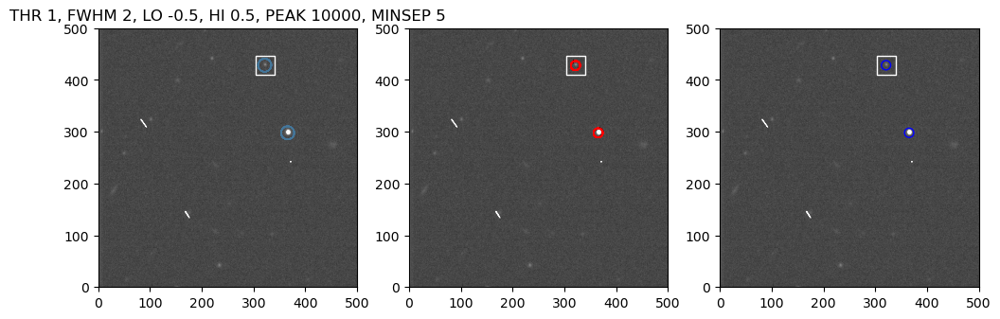

In [22]:
#test on problematic images
_ = defs.psffittests(GaussianPRF(x_fwhm=fwhm*header['FWHM'], y_fwhm=fwhm*header['FWHM']), threshold, fwhm, roundlo, roundhi, 
                 peakmax, minsep, imgs, xycoords, flare_ref_pos, plot=True, report=True)
                                                                                                

0
Background: 22.61159896850586
Seeing: 1.169462034 arcsec
nsources detected 92
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 92
1
Background: 22.213088989257812
Seeing: 1.1767570308 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 320.84477337862006 428.49125917830986
matchescount 91, [0, 1]
celest finder chart, black photometry output, blue matched output


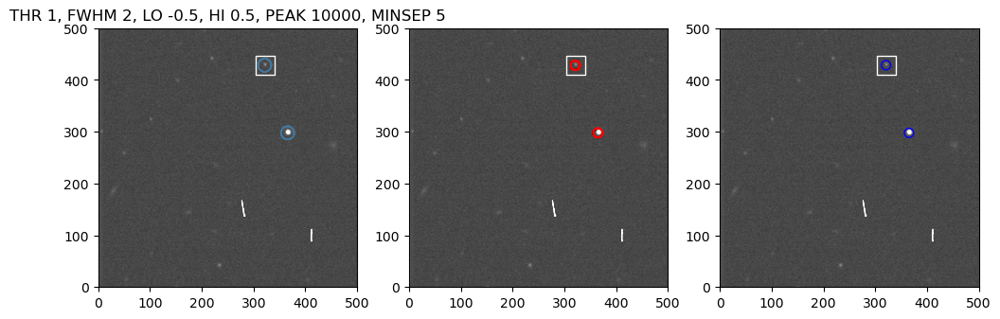

2
Background: 21.96426773071289
Seeing: 1.227742371 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 320.95756817965923 428.18548564293457
matchescount 91, [0, 1, 1]
celest finder chart, black photometry output, blue matched output


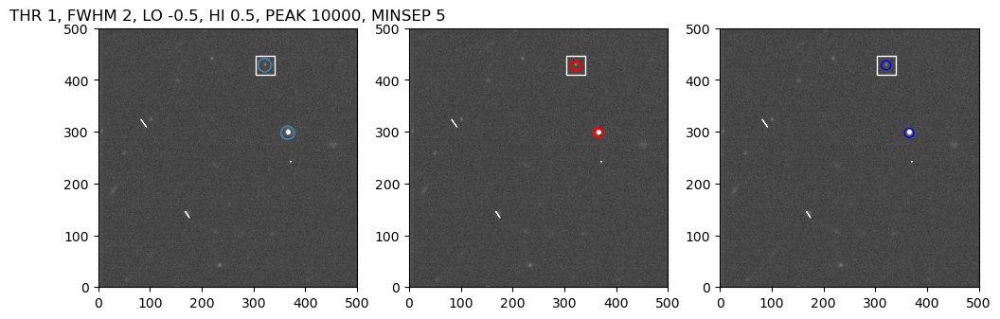

In [23]:
#test on problematic images
psfmodel = GaussianPRF()
psfmodel.x_fwhm.fixed = False
psfmodel.y_fwhm.fixed = False
_ = defs.psffittests(psfmodel, threshold, fwhm, roundlo, roundhi, 
                 peakmax, minsep, imgs, xycoords, flare_ref_pos, plot=True, report=True)


0
Background: 22.61159896850586
Seeing: 1.169462034 arcsec
nsources detected 92
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 92
1
Background: 22.213088989257812
Seeing: 1.1767570308 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 321.358889770591 428.44503535328187
matchescount 91, [0, 1]
celest finder chart, black photometry output, blue matched output


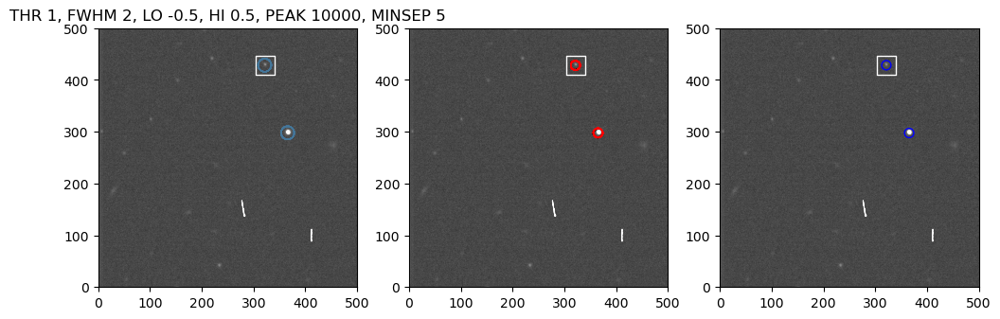

2
Background: 21.96426773071289
Seeing: 1.227742371 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 321.4575615869917 427.7129890642618
matchescount 91, [0, 1, 1]
celest finder chart, black photometry output, blue matched output


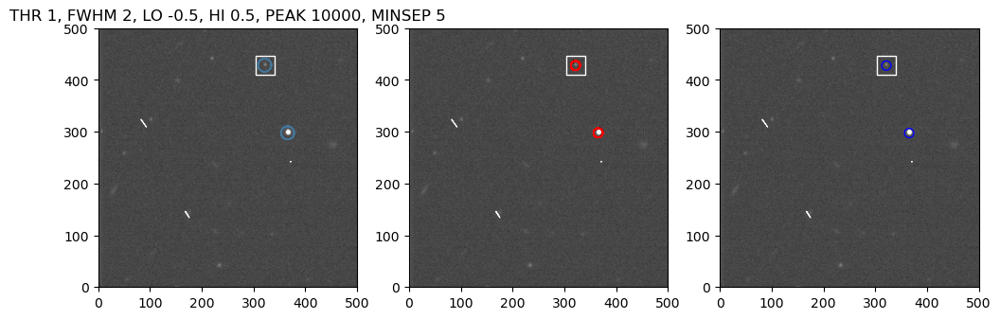

In [24]:

_ = defs.psffittests(MoffatPSF(), threshold, fwhm, roundlo, roundhi, 
                 peakmax, minsep, imgs, xycoords, flare_ref_pos, plot=True, report=True)


0
Background: 22.61159896850586
Seeing: 1.169462034 arcsec
nsources detected 92
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 92
build PSF model


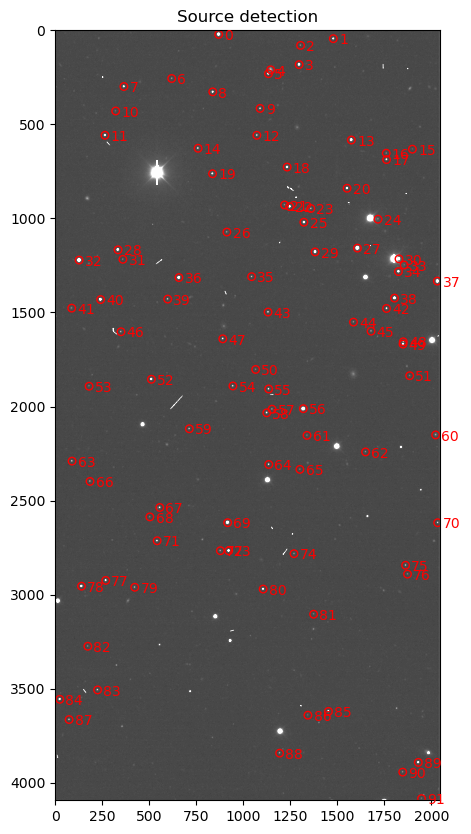

<Figure size 640x480 with 0 Axes>

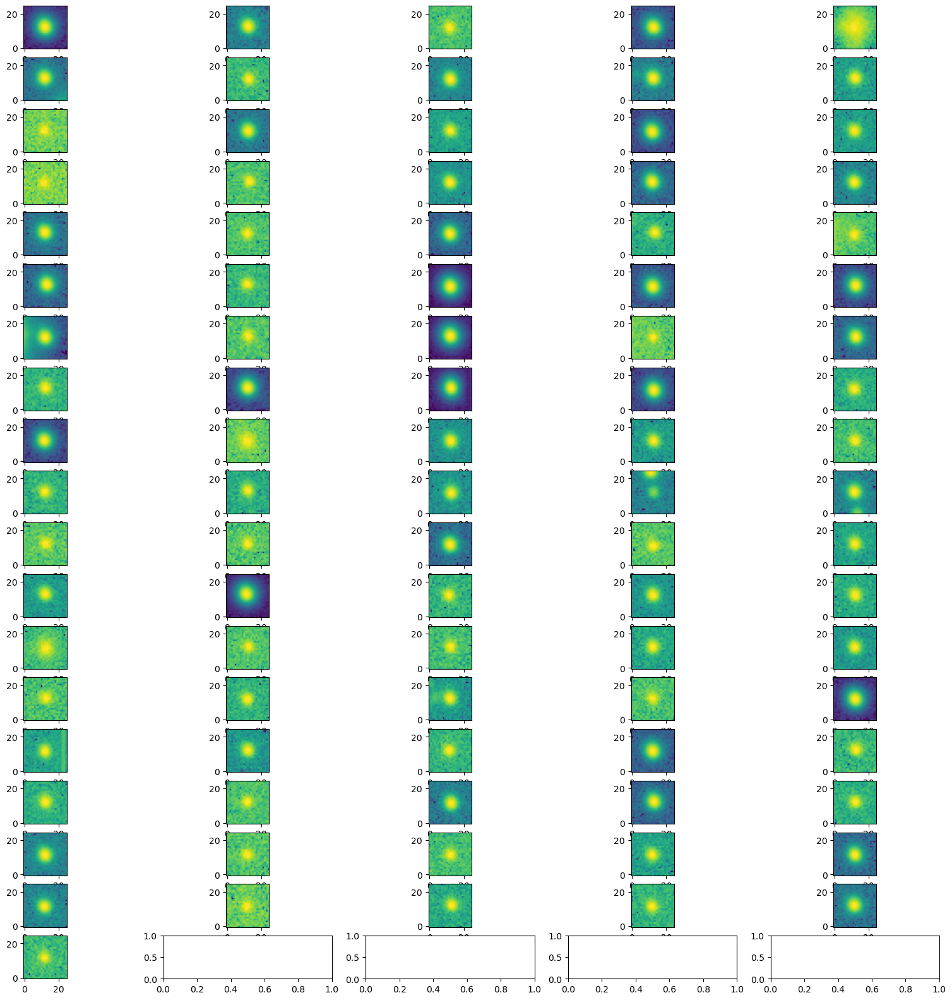

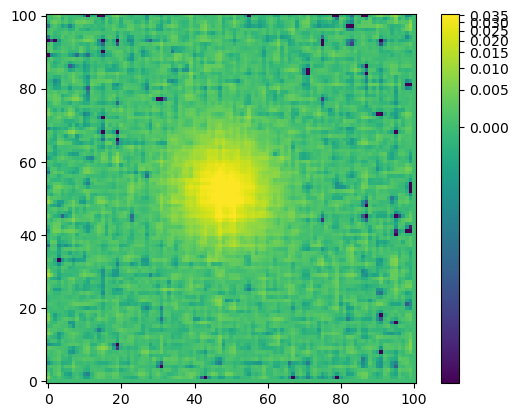

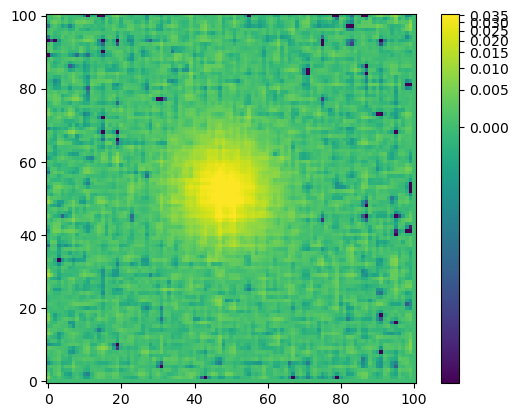

1
Background: 22.213088989257812
Seeing: 1.1767570308 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
build PSF model


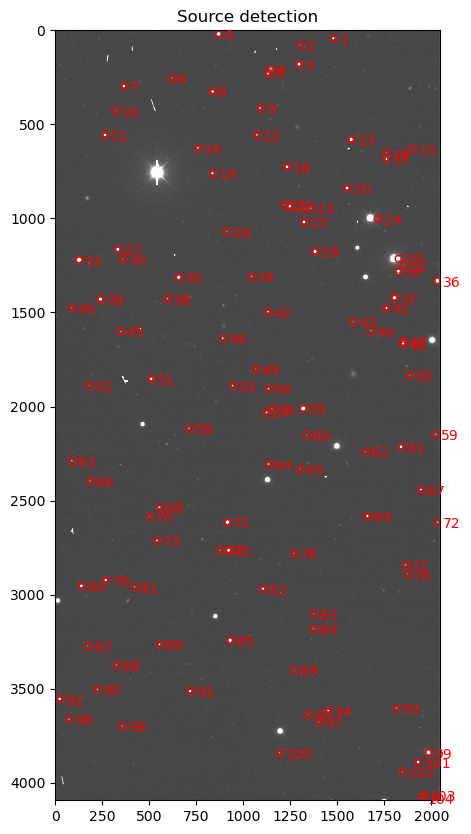

<Figure size 640x480 with 0 Axes>

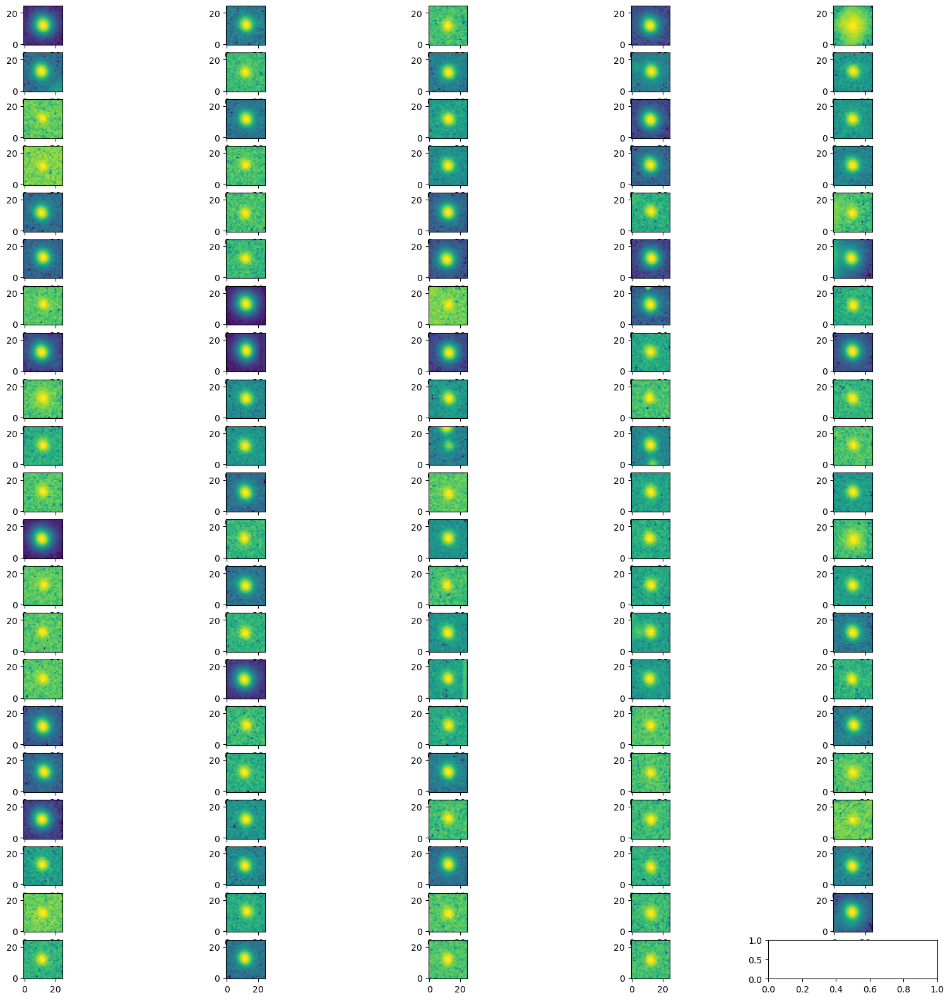

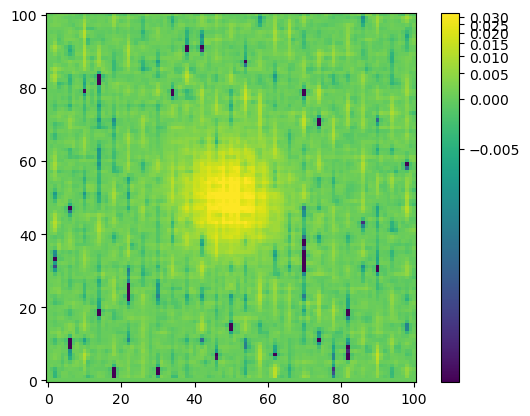

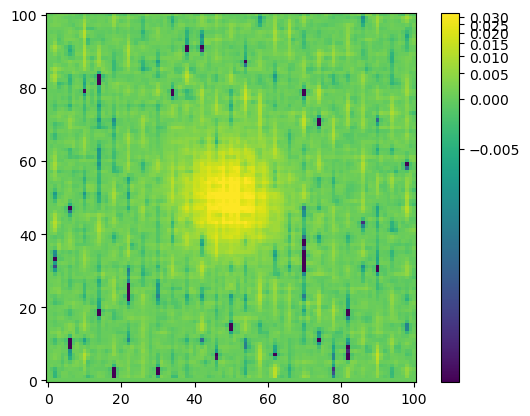

photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 321.30476679049644 428.0505416817532
matchescount 91, [0, 1]
celest finder chart, black photometry output, blue matched output


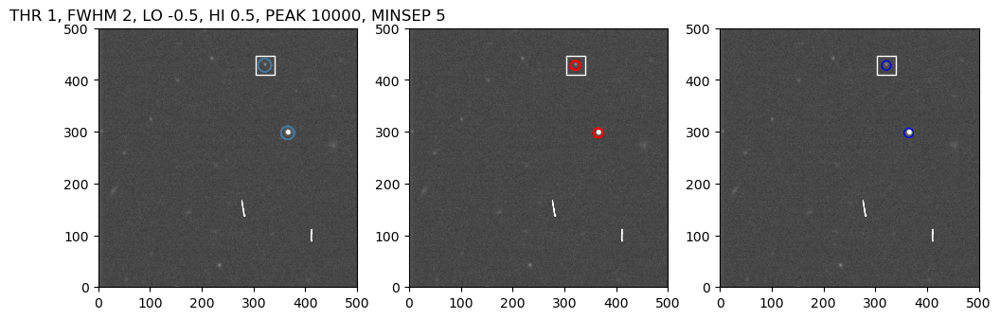

2
Background: 21.96426773071289
Seeing: 1.227742371 arcsec
nsources detected 105
good combo THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
nsources detected 105
build PSF model


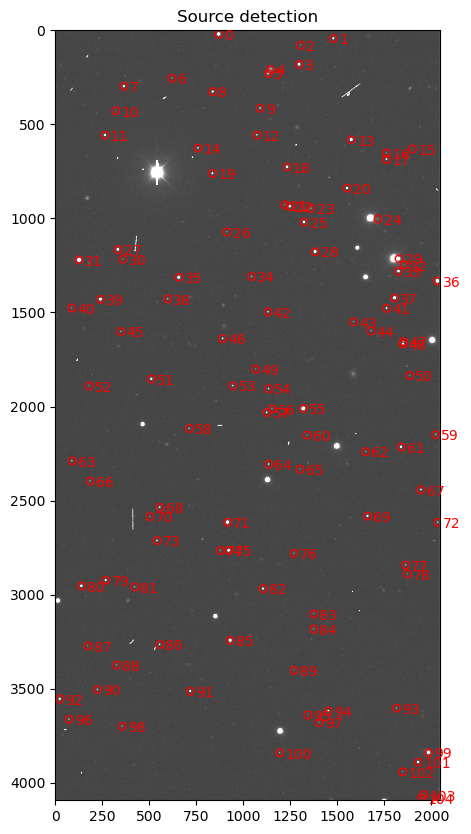

<Figure size 640x480 with 0 Axes>

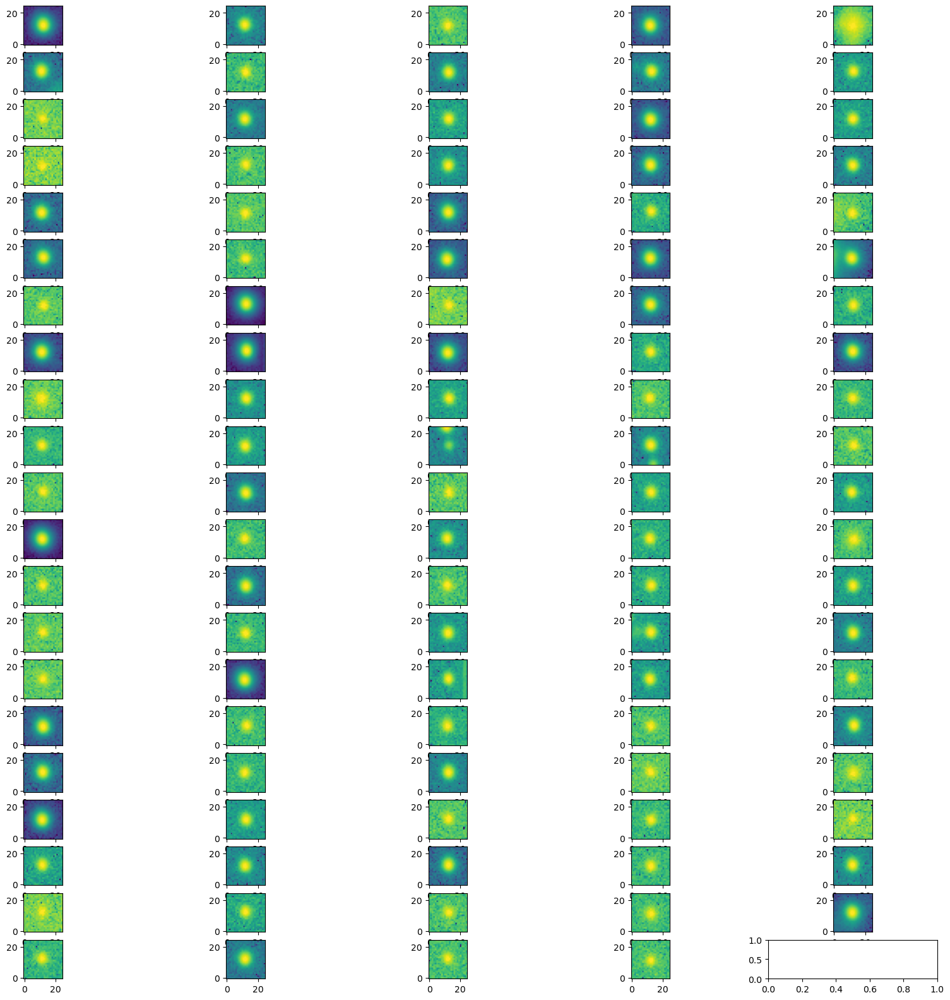

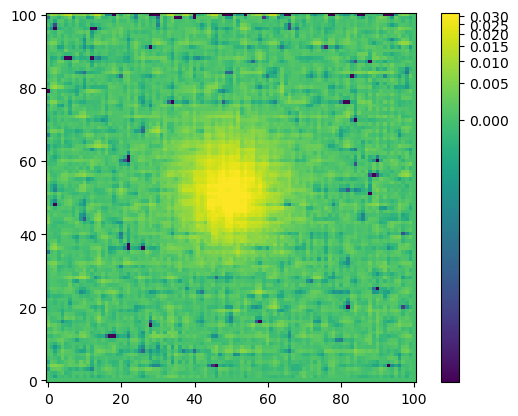

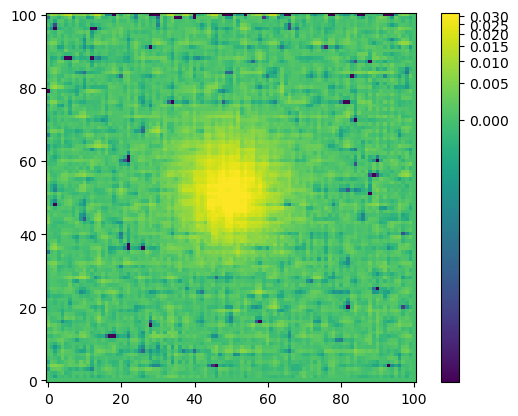

photometry sources 105
THR 1, FWHM 2, LO -0.5, HI 0.5, PEAK 10000, MINSEP 5
10 is a possible match with the target star
	 322.0 428.5
	 321.27974724306245 427.78447396475354
matchescount 91, [0, 1, 1]
celest finder chart, black photometry output, blue matched output


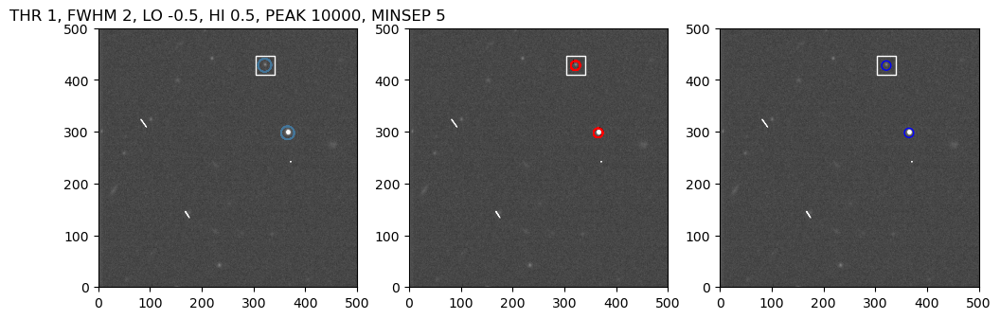

In [25]:
_ = defs.psffittests(None, threshold, fwhm, roundlo, roundhi, 
                 peakmax, minsep, imgs, xycoords, flare_ref_pos, plot=True, report=True)


# FINAL PSF MODELS: NON-CIRCULAR GAUSSIAN WITHOUT FIXED FWHM

1/74
b5179de7a72a8849306cf70093d016bc_c4d_151218_054742_ooi_g_v1_S18.fits.fz
nsources detected 92
2/74
44e34c2464b4477790f1ddab41a0cf7c_c4d_151218_054831_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


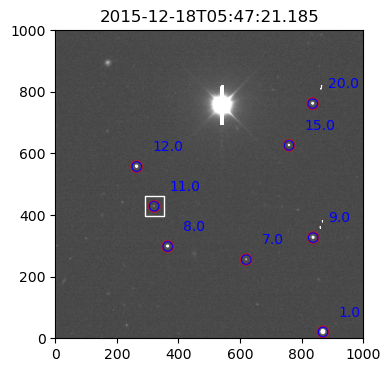

3/74
d2b98624b2c1e0051043ed108f6e7c63_c4d_151218_054916_ooi_g_v1_S18.fits.fz
nsources detected 103
did we macth flare star? YES
matchescount 91, 1


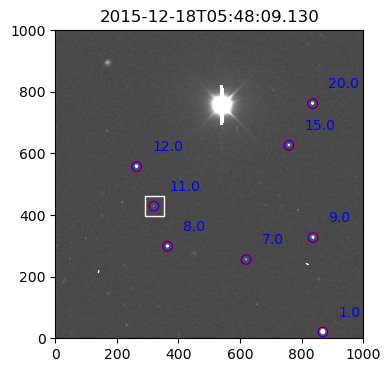

4/74
370d8dbb65092bb228338aadcd46c158_c4d_151218_055006_ooi_g_v1_S18.fits.fz
nsources detected 99
did we macth flare star? YES
matchescount 90, 1


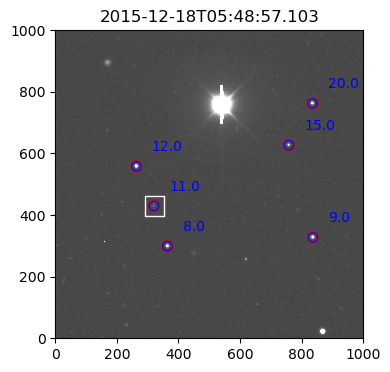

5/74
ade32d4a253351f296c2bd61b1948fb5_c4d_151218_055051_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


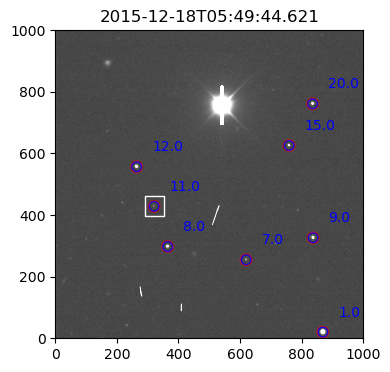

6/74
bda9e563645b4ef7e7f01338339cebdc_c4d_151218_055143_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


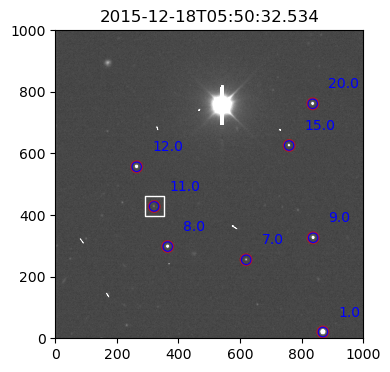

7/74
5e5d19a8b76fc07db04a6498ed480980_c4d_151218_055228_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 90, 1


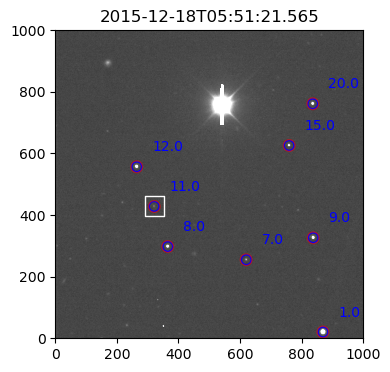

8/74
2984aa9c1e3c5a7fcdf1cf6112c01dc3_c4d_151218_055317_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


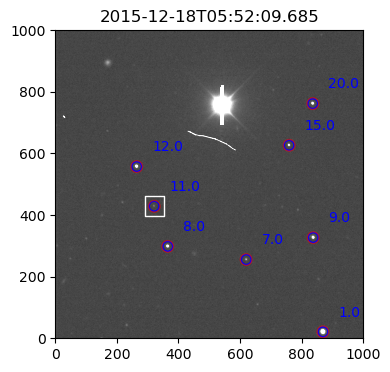

9/74
a9d2b01d33deca7b8e003abc0dd40e37_c4d_151218_055407_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


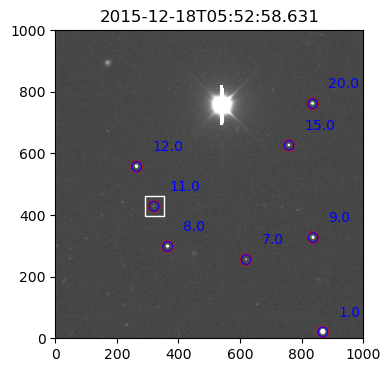

10/74
afb98733c62918af1816248b74cc446e_c4d_151218_055454_ooi_g_v1_S18.fits.fz
nsources detected 96
did we macth flare star? YES
matchescount 92, 1


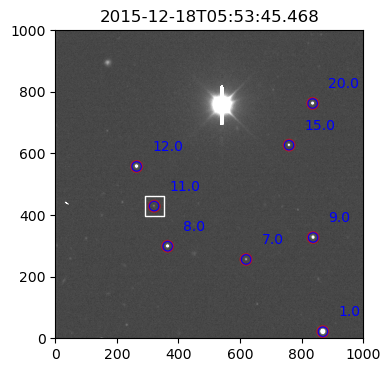

11/74
c5cab604683b516a212870ffab507f17_c4d_151218_055541_ooi_g_v1_S18.fits.fz
nsources detected 104
did we macth flare star? YES
matchescount 92, 1


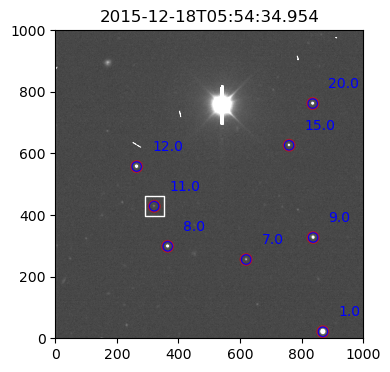

12/74
5fad601ba381f997e2b6c5948853adcb_c4d_151218_055629_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


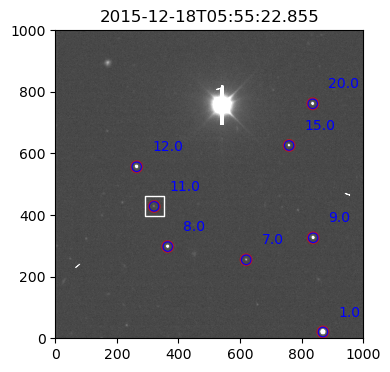

13/74
997f4475f26a50f2fab9aca7057bc34d_c4d_151218_055720_ooi_g_v1_S18.fits.fz
nsources detected 104
did we macth flare star? YES
matchescount 91, 1


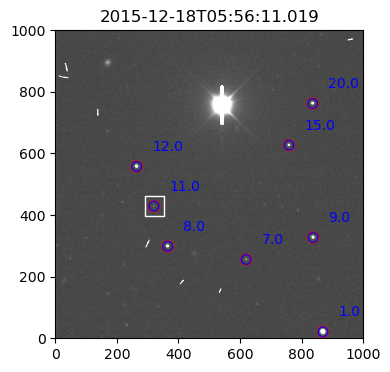

14/74
b9c32879cc22a5aa96520a31801615f1_c4d_151218_055809_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 92, 1


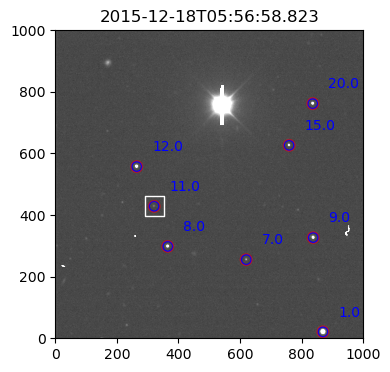

15/74
092570474462779fa0ac545c74b697bf_c4d_151218_055856_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


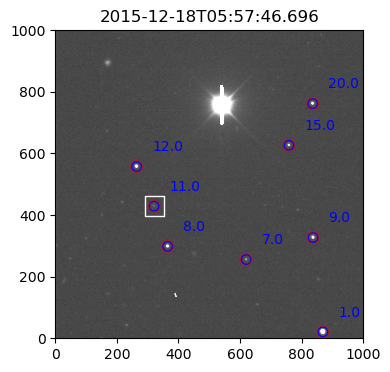

16/74
d9fc42e90f8eeef6fdd6cb92dc0241c9_c4d_151218_055947_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


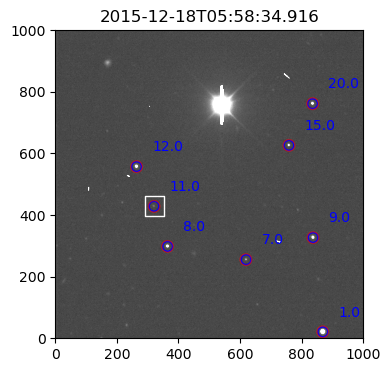

17/74
26c13b50b705e7924e5ea246b642523c_c4d_151218_060031_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


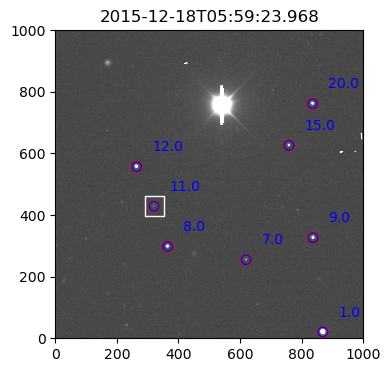

18/74
caf8c3bd78fbdbd32577a51c46801830_c4d_151218_060118_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


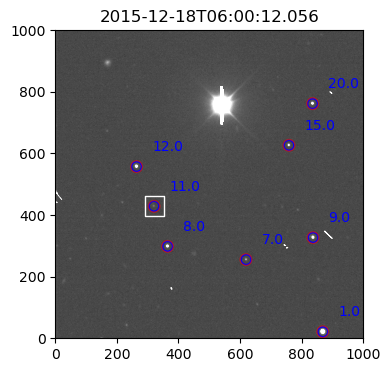

19/74
2e729528f63c6e173baaaf5b54df535d_c4d_151218_060208_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


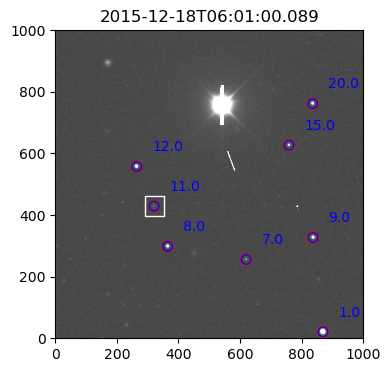

20/74
304cd4134c9535600fe55c7e63a71053_c4d_151218_060257_ooi_g_v1_S18.fits.fz
nsources detected 107
did we macth flare star? YES
matchescount 92, 1


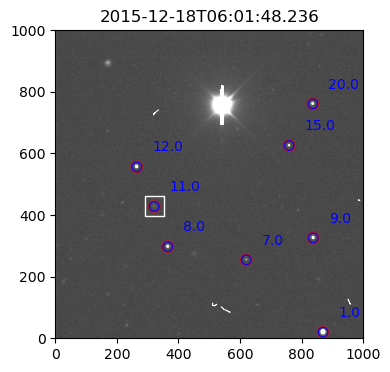

21/74
86dc03d642083c4411ef7acb103b7ed6_c4d_151218_060346_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


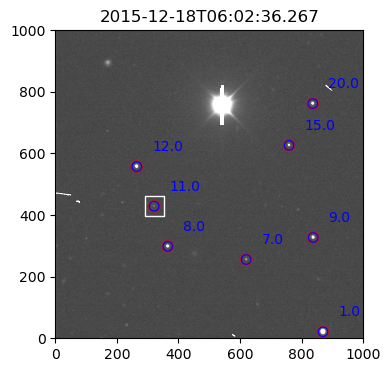

22/74
a9dced316614c919819ec7e155f4216a_c4d_151218_060433_ooi_g_v1_S18.fits.fz
nsources detected 104
did we macth flare star? YES
matchescount 92, 1


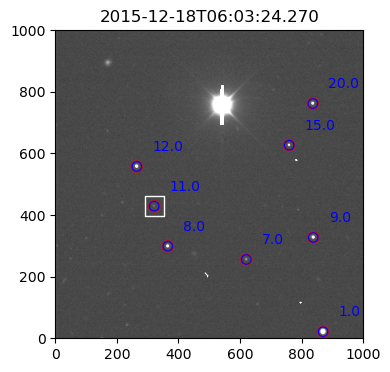

23/74
83f149944c64806aaa5454648d982d9e_c4d_151218_060521_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


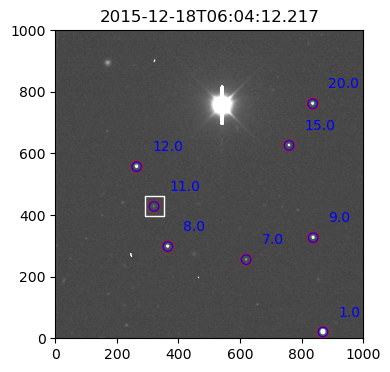

24/74
d904d4f514304d4f048be5ce85bf2c47_c4d_151218_060609_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 92, 1


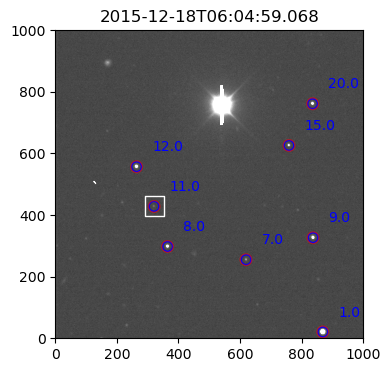

25/74
054934c394a7e0349352f660bfe1802b_c4d_151218_060655_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


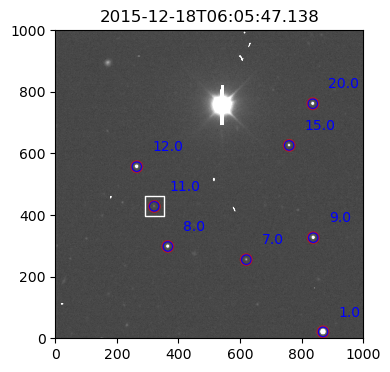

26/74
a58663caadc8b97bfaf4df72ed40e359_c4d_151218_060746_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


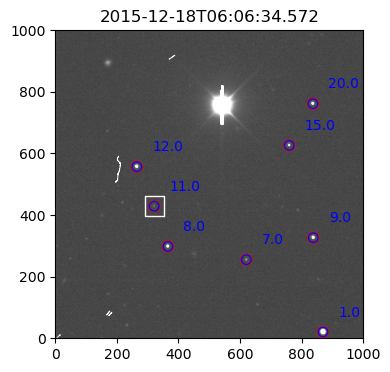

27/74
7ef731f77677d0bc75720d46628965ea_c4d_151218_060834_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 92, 1


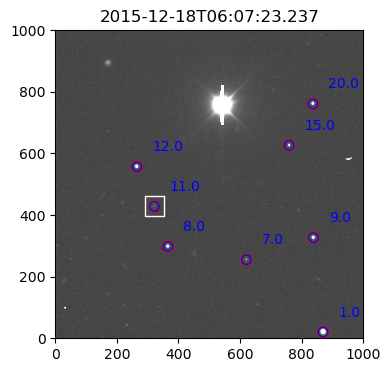

28/74
72804a00ade9048948bec579a6c1ba3b_c4d_151218_060925_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


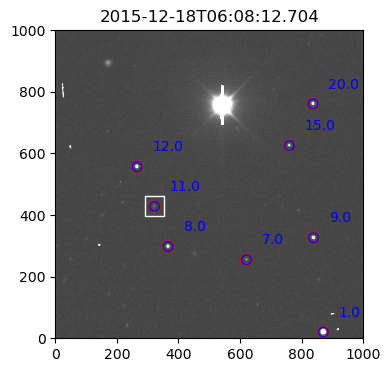

29/74
01f29585b8ab98b9445263645de2b759_c4d_151218_061011_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


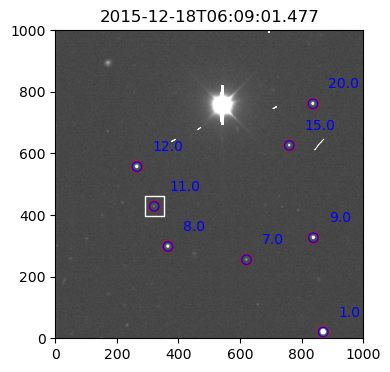

30/74
9719d5936f044286414621fffbf331a8_c4d_151218_061057_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


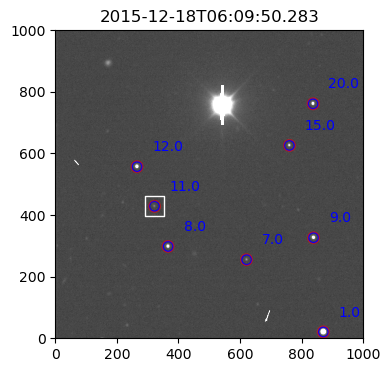

31/74
489f990fd94eb9cff4b14219e98b6bde_c4d_151218_061146_ooi_g_v1_S18.fits.fz
nsources detected 107
did we macth flare star? YES
matchescount 91, 1


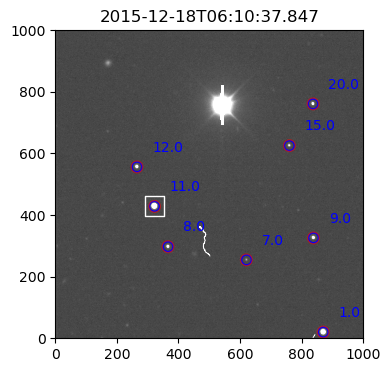

32/74
b4fd011a982f3ea4a2d00f14bb454f12_c4d_151218_061233_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


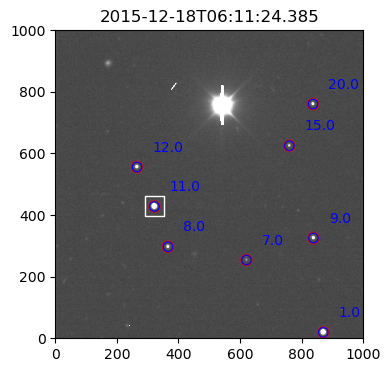

33/74
f4facbcacb39955e95a1e203476c0827_c4d_151218_061322_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


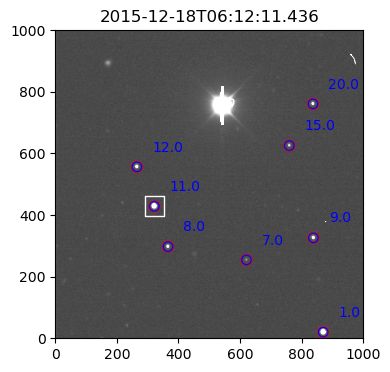

34/74
8c580798670c1fdc4ba4b9b98d649a9e_c4d_151218_061408_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


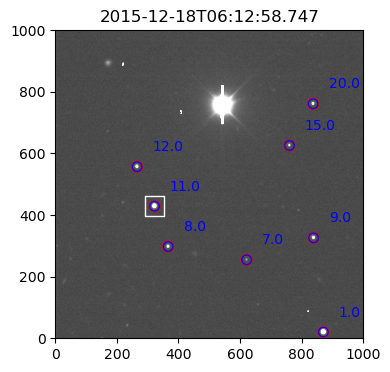

35/74
6e069b3ba2f921accc6c6bf54fbc8ea1_c4d_151218_061457_ooi_g_v1_S18.fits.fz
nsources detected 97
did we macth flare star? YES
matchescount 83, 1


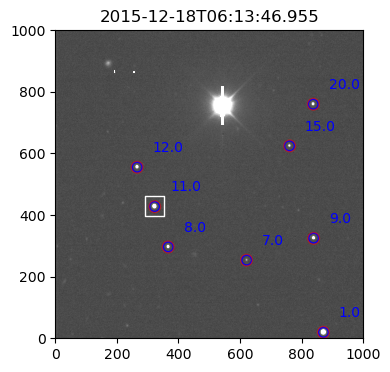

36/74
a537628670f94cbad17844c8821ca0df_c4d_151218_061546_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 92, 1


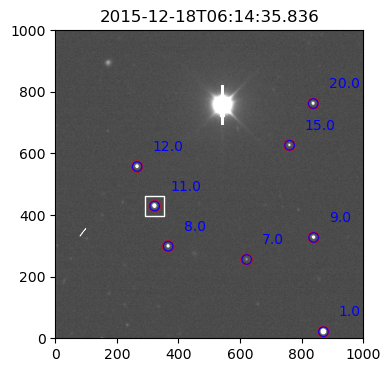

37/74
78072e64a2f620c81605bd60cbd54982_c4d_151218_061632_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


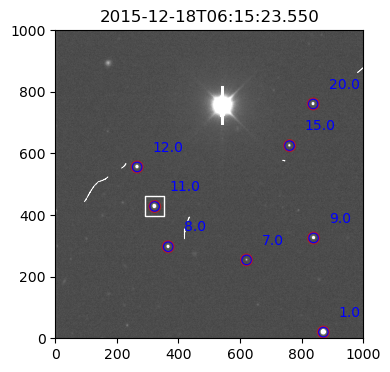

38/74
17dc442bf455de4ea83d3ccad3a9e54f_c4d_151218_061719_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 92, 1


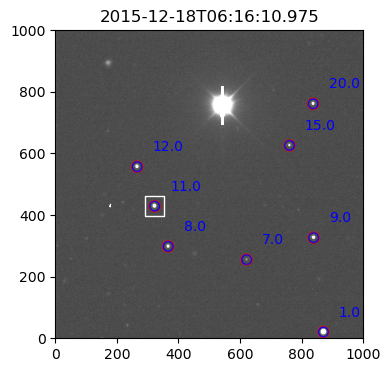

39/74
0a7936112f3150350b27277900f88de2_c4d_151218_061807_ooi_g_v1_S18.fits.fz
nsources detected 102
did we macth flare star? YES
matchescount 89, 1


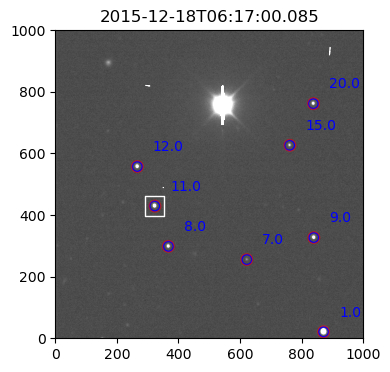

40/74
c924e401218b4ed9c25e2a55bf0bbedd_c4d_151218_061858_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 92, 1


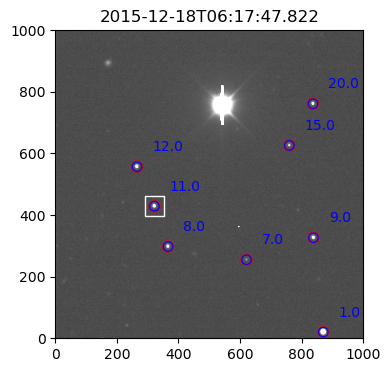

41/74
cf9d14efbf7ba9102f7035ac9ceab486_c4d_151218_061944_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


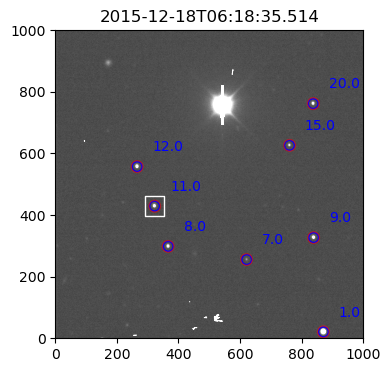

42/74
4ecbbf934350cf5801eef02cccc0e498_c4d_151218_062033_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


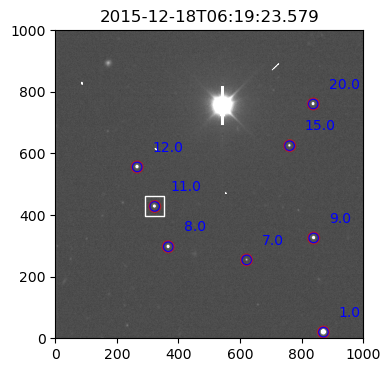

43/74
2435659a4749c786de394d194177803c_c4d_151218_062120_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


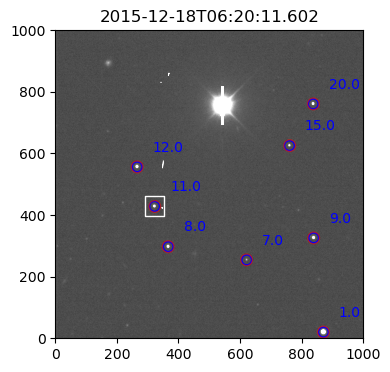

44/74
fcf8eb4a0b47e7ddfd27bc449068272c_c4d_151218_062206_ooi_g_v1_S18.fits.fz
nsources detected 103
did we macth flare star? YES
matchescount 89, 1


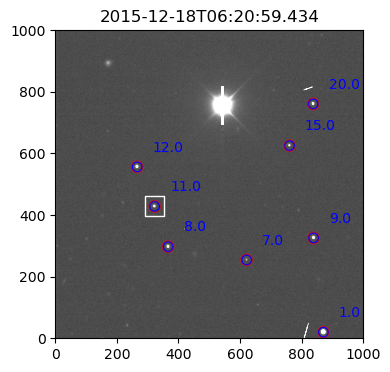

45/74
98f24caf62d1ebb176cc6d5578d32962_c4d_151218_062257_ooi_g_v1_S18.fits.fz
nsources detected 102
did we macth flare star? YES
matchescount 89, 1


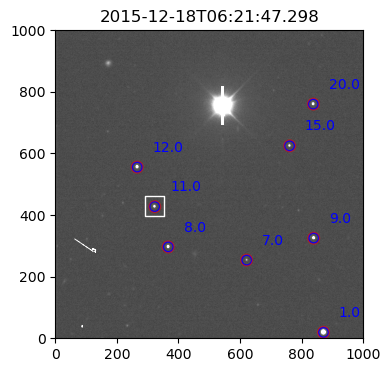

46/74
e451087bba169e5a56c9544a7bd3e1d9_c4d_151218_062343_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


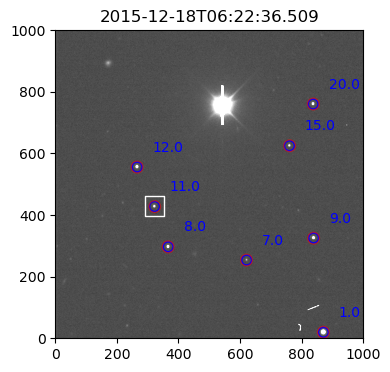

47/74
1cdbdc88531d5b2b7de7a8bc1ade7597_c4d_151218_062434_ooi_g_v1_S18.fits.fz
nsources detected 97
did we macth flare star? YES
matchescount 84, 1


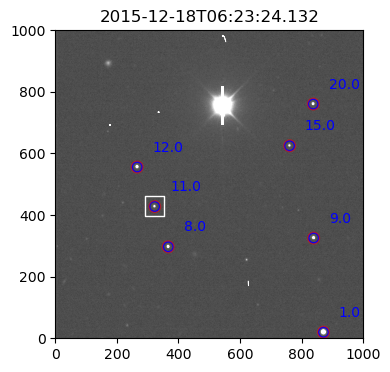

48/74
60b48043a80da2f90b74ffbc7153f3d8_c4d_151218_062521_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


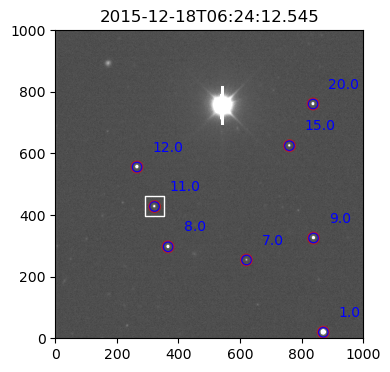

49/74
8992d6a3c15f3549efda17170c3b6c14_c4d_151218_062609_ooi_g_v1_S18.fits.fz
nsources detected 103
did we macth flare star? YES
matchescount 89, 1


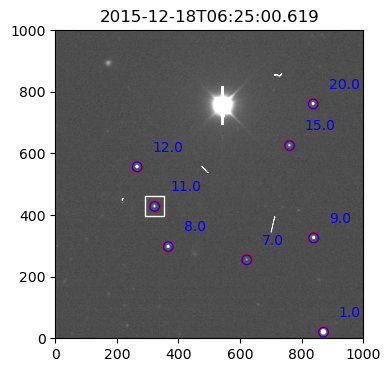

50/74
9607e49b49be0827a15b4172ca605b7b_c4d_151218_062657_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


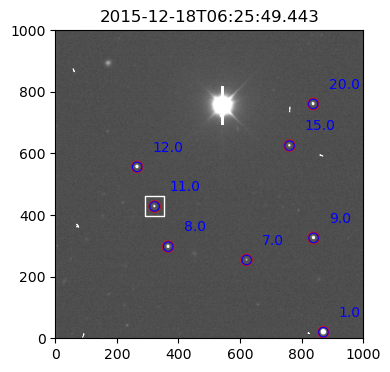

51/74
dbd3d1aac2274006f6751d38d92e340c_c4d_151218_062749_ooi_g_v1_S18.fits.fz
nsources detected 87
did we macth flare star? YES
matchescount 73, 1


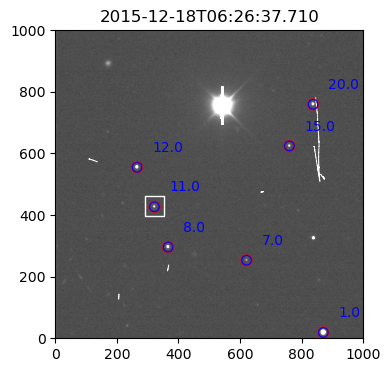

52/74
e0bf5d422d13701c27eae44968bb651f_c4d_151218_062835_ooi_g_v1_S18.fits.fz
nsources detected 101
did we macth flare star? YES
matchescount 87, 1


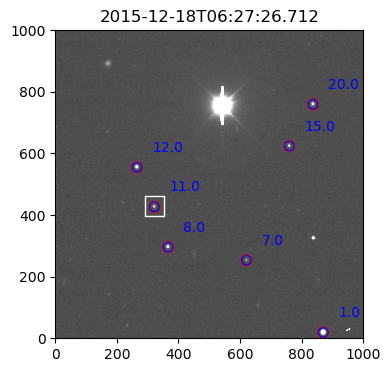

53/74
fbbb587f979f62286628fdd8d08f3bf9_c4d_151218_062922_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


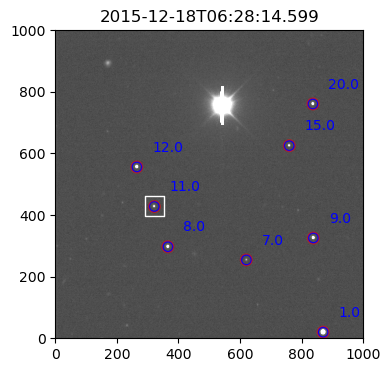

54/74
f6e1aaf4be6b889f3eba20fb1f5fdd1d_c4d_151218_063011_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


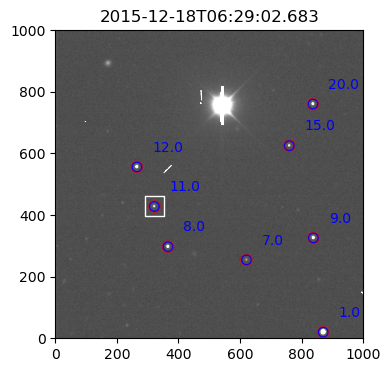

55/74
4f7a5868afdeb5ece6972056a69ab0dd_c4d_151218_063100_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


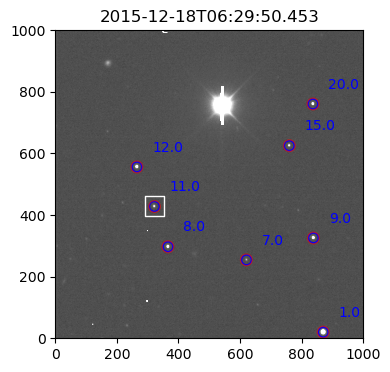

56/74
24bcad2dbb142669ef83dc8d10629336_c4d_151218_063145_ooi_g_v1_S18.fits.fz
nsources detected 98
did we macth flare star? YES
matchescount 84, 1


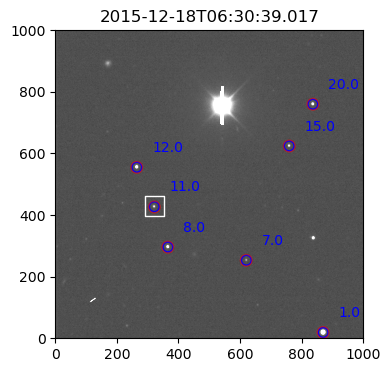

57/74
65e593e22dd9df5170fcaece030ab2f3_c4d_151218_063237_ooi_g_v1_S18.fits.fz
nsources detected 95
did we macth flare star? YES
matchescount 86, 1


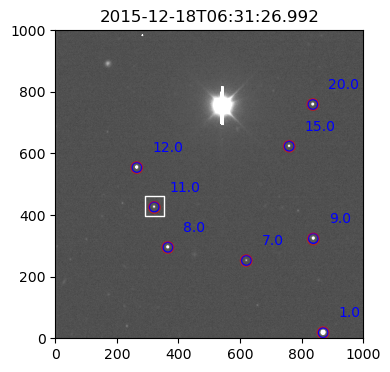

58/74
9cdfd8a312a3c550e0fa29a5a8c6097a_c4d_151218_063324_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


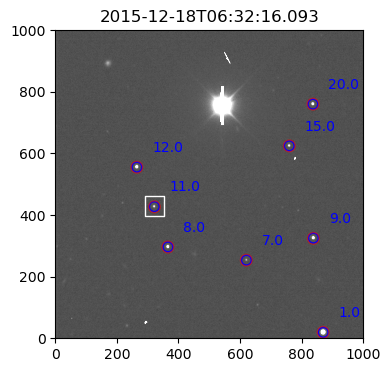

59/74
67e977300baf143b1f282ed6a2a813f1_c4d_151218_063413_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


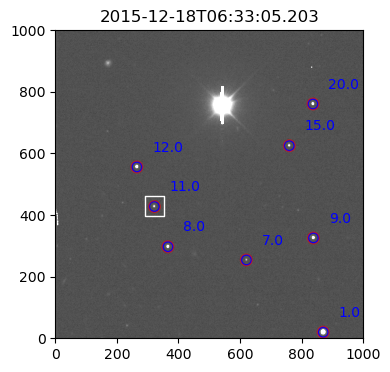

60/74
68fef451244f3c1d0fa8311e307f3187_c4d_151218_063502_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


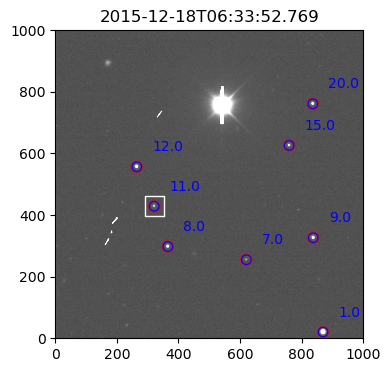

61/74
5f7d7b3a43c128df8435b4a9a8bebf34_c4d_151218_063550_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 91, 1


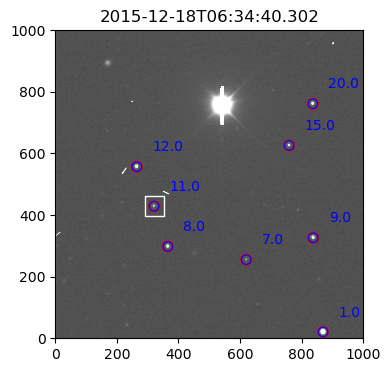

62/74
e1f69cfe2067033a47aab4f46bded86d_c4d_151218_063636_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


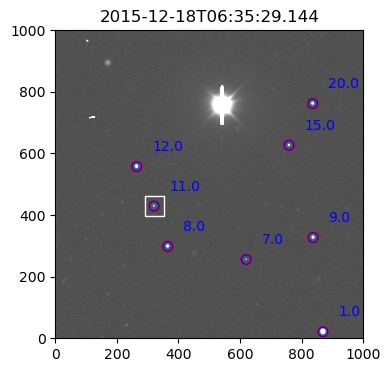

63/74
3f186ff03ab473e7f68eff74caa16c04_c4d_151218_063727_ooi_g_v1_S18.fits.fz
nsources detected 106
did we macth flare star? YES
matchescount 92, 1


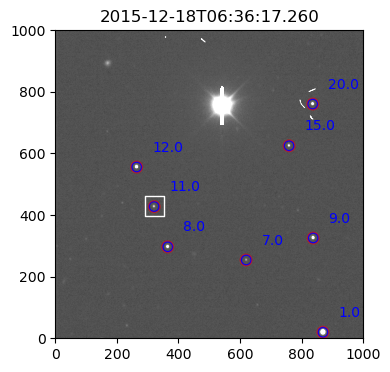

64/74
0e0e4605d2aaaf71dd4f639a6b77410c_c4d_151218_063813_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


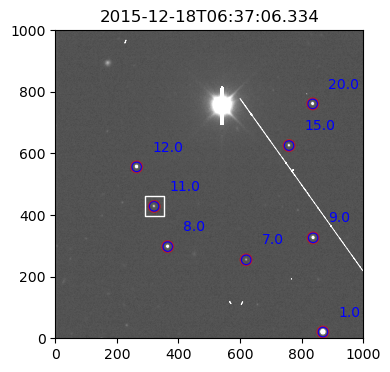

65/74
3515dce920dd2d0876904a6e1d6682e5_c4d_151218_063903_ooi_g_v1_S18.fits.fz
nsources detected 102
did we macth flare star? YES
matchescount 88, 1


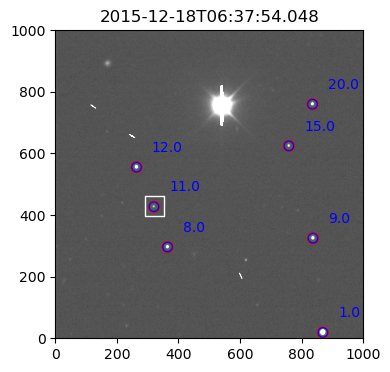

66/74
02f9935b7e8eb284b017ac526d34362b_c4d_151218_063952_ooi_g_v1_S18.fits.fz
nsources detected 89
did we macth flare star? YES
matchescount 84, 1


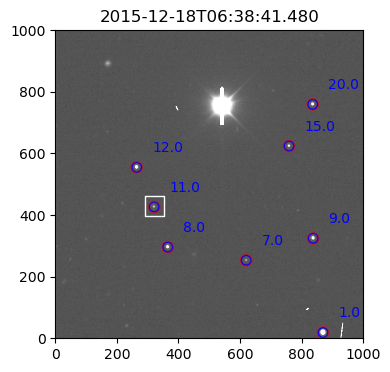

67/74
39233eb4e3ce2f496fc939ffe00aa1f3_c4d_151218_064038_ooi_g_v1_S18.fits.fz
nsources detected 102
did we macth flare star? YES
matchescount 89, 1


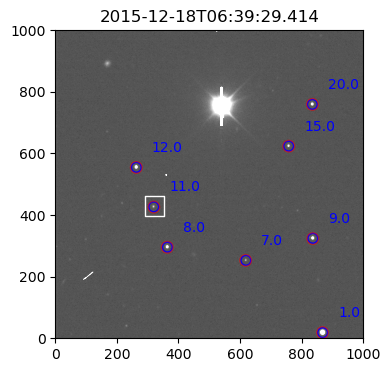

68/74
40f37b614c9764831187f9bb06ff04c6_c4d_151218_064129_ooi_g_v1_S18.fits.fz
nsources detected 99
did we macth flare star? YES
matchescount 86, 1


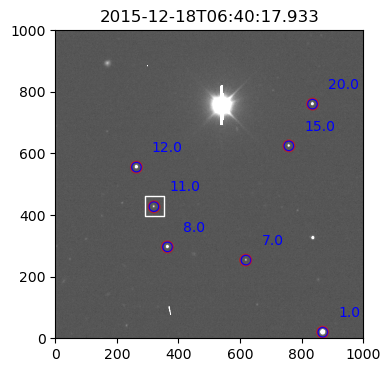

69/74
ccd5b5b01509880da3c00e8011c65183_c4d_151218_064215_ooi_g_v1_S18.fits.fz
nsources detected 91
did we macth flare star? YES
matchescount 78, 1


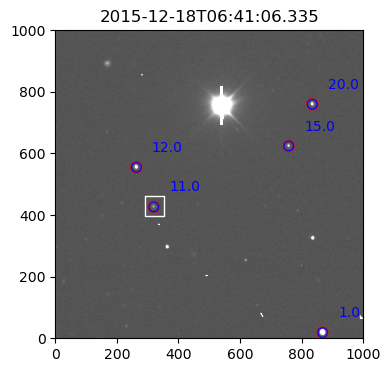

70/74
19020e0bd9f39005fab8eb8aebef49ac_c4d_151218_064301_ooi_g_v1_S18.fits.fz
nsources detected 104
did we macth flare star? YES
matchescount 90, 1


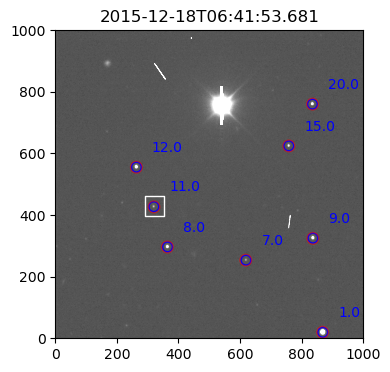

71/74
66b2aedd8e371fbf748a0f75ad9b1652_c4d_151218_064348_ooi_g_v1_S18.fits.fz
nsources detected 105
did we macth flare star? YES
matchescount 91, 1


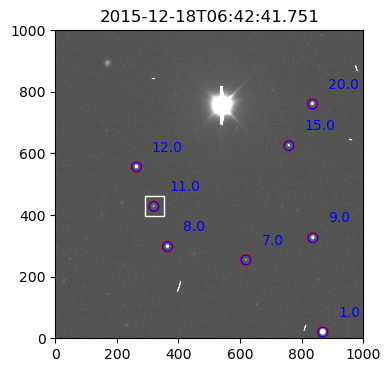

72/74
066fea43b2c779898ab9af2017964e21_c4d_151218_064437_ooi_g_v1_S18.fits.fz
nsources detected 99
did we macth flare star? YES
matchescount 88, 1


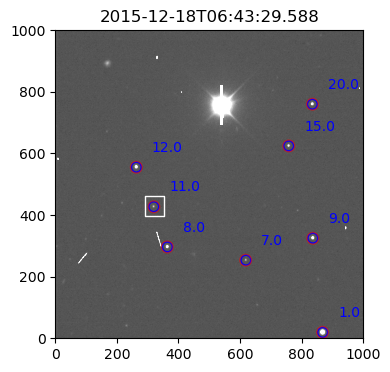

73/74
bb80830e498d95fbf625ab55364d769a_c4d_151218_064526_ooi_g_v1_S18.fits.fz
nsources detected 95
did we macth flare star? YES
matchescount 81, 1


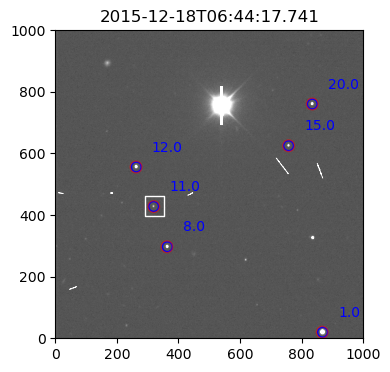

74/74
25872bcfd0d9486c738f613a4f8f31e3_c4d_151218_064614_ooi_g_v1_S18.fits.fz
nsources detected 99
did we macth flare star? YES
matchescount 85, 1


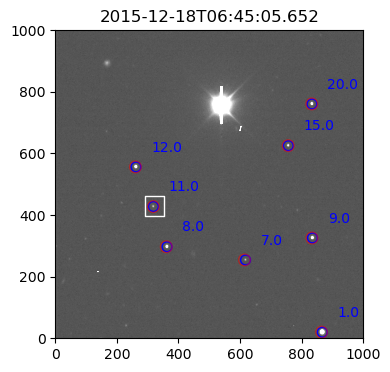

In [26]:
flr_id = 11 #look above at the print statements from the test: 11 is a possible match with the target star
match_dist = 1

gaussianmodel = GaussianPRF()
gaussianmodel.x_fwhm.fixed = False
gaussianmodel.y_fwhm.fixed = False

main_df_Gaussian, matchescounts_Gaussian = defs.extract((start,end), gaussianmodel, imnames_timeordered, xycoords, 
                                                        threshold, fwhm, roundlo, roundhi, peakmax, minsep,
                                                        flare_ref_pos, fit_shape, match_dist, flr_id, plot=False)

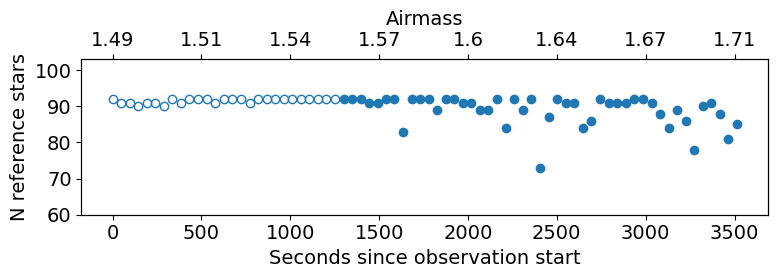

In [43]:
flare_reference = np.load("Outdata/finds.npy")
flare_df = pd.read_csv("Outdata/flare_df.csv")

matchescounts_Gaussian = np.array(matchescounts_Gaussian)
time = main_df_Gaussian.sort_values('time')
time = time['time'].unique()
time = time[~np.isnan(time)] *24 * 60 * 60
fig, ax = plt.subplots(1, 1, figsize=(8,3))
plt.rcParams['font.size']=14
plt.plot((time - time[0])[~flare_reference], matchescounts_Gaussian[~flare_reference], color='C0', marker='o', ls='None', mfc="None")
plt.plot((time - time[0])[flare_reference], matchescounts_Gaussian[flare_reference], color='C0', marker='o', ls='None')
plt.ylabel("N reference stars", fontsize=14)
plt.ylim(60,103)
plt.yticks(range(60,105,10))
plt.xlabel('Seconds since observation start', fontsize=14);
subax0 = ax.twiny()
subax0.set_xticklabels(np.round(flare_df.am[::8], decimals=2), fontsize=8)
subax0.set_xlim(ax.get_xlim())
subax0.set_xlabel('Airmass', fontsize=14)
subax0.tick_params(labelsize=14)
 
fig.tight_layout()

plt.savefig('Figures/Nreferencestars.png', dpi = 300, bbox_inches='tight')


In [192]:
plt.rcParams.keys() 

KeysView(RcParams({'_internal.classic_mode': False,
          'agg.path.chunksize': 0,
          'animation.bitrate': -1,
          'animation.codec': 'h264',
          'animation.convert_args': ['-layers', 'OptimizePlus'],
          'animation.convert_path': 'convert',
          'animation.embed_limit': 20.0,
          'animation.ffmpeg_args': [],
          'animation.ffmpeg_path': 'ffmpeg',
          'animation.frame_format': 'png',
          'animation.html': 'none',
          'animation.writer': 'ffmpeg',
          'axes.autolimit_mode': 'data',
          'axes.axisbelow': 'line',
          'axes.edgecolor': 'black',
          'axes.facecolor': 'white',
          'axes.formatter.limits': [-5, 6],
          'axes.formatter.min_exponent': 0,
          'axes.formatter.offset_threshold': 4,
          'axes.formatter.use_locale': False,
          'axes.formatter.use_mathtext': False,
          'axes.formatter.useoffset': True,
          'axes.grid': False,
          'axes.grid.axis': 'b

In [186]:
np.array([(main_df_Gaussian.id == i).sum()for i in range(93)])[np.array([(main_df_Gaussian.id == i).sum() for i in range(93)]).argsort()]

array([ 0, 34, 64, 68, 68, 68, 68, 68, 69, 69, 70, 70, 70, 70, 70, 71, 71,
       71, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 72, 73, 73,
       73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73, 73,
       73, 73, 73, 73, 73, 73, 73, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74,
       74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74, 74,
       74, 74, 74, 74, 74, 74, 74, 99])

In [28]:
main_df = main_df_Gaussian #main_df_Imagemodel
print(main_df.shape)
main_df = main_df.sort_values('time')
main_df = main_df.dropna(how="all")

main_df.to_csv('Outdata/main_df_GaussPSF.csv', index=False)
print(main_df.shape)

main_df.head();

(7636, 28)
(6660, 28)


What's the flare stars ID?

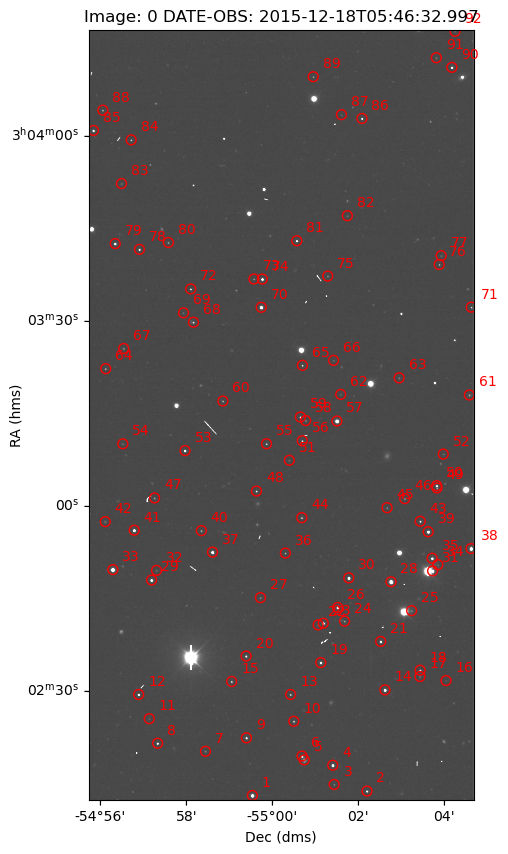

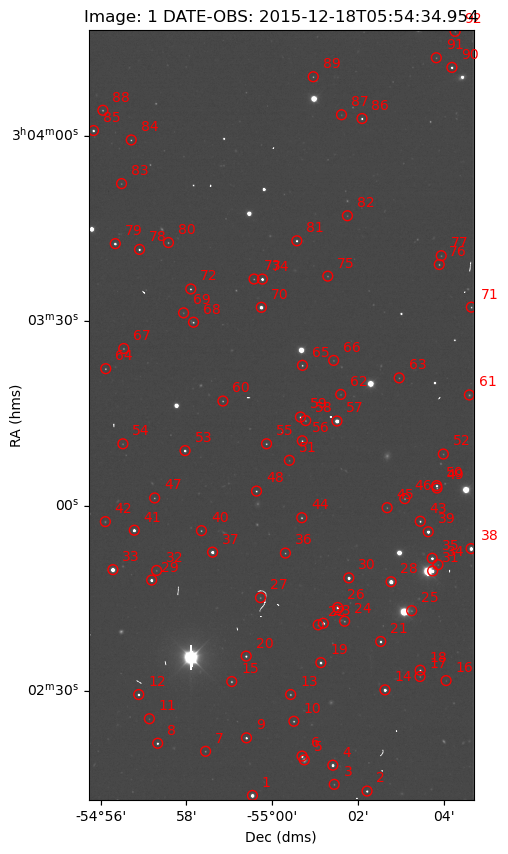

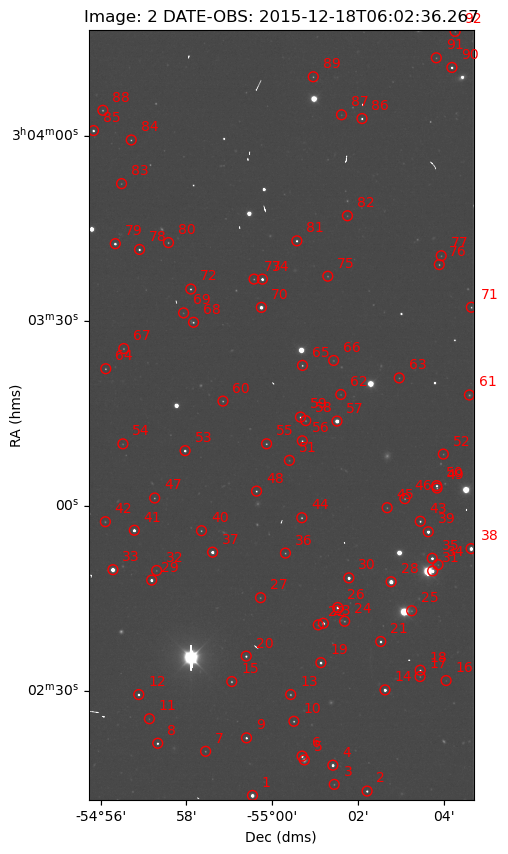

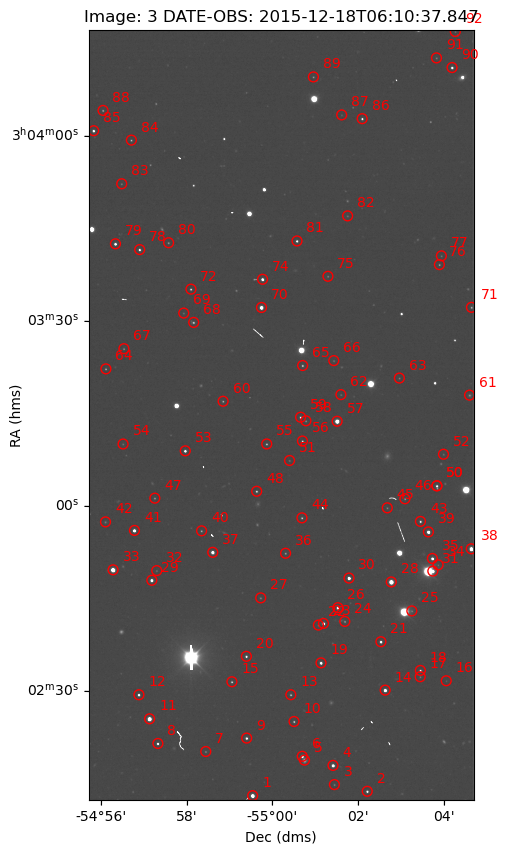

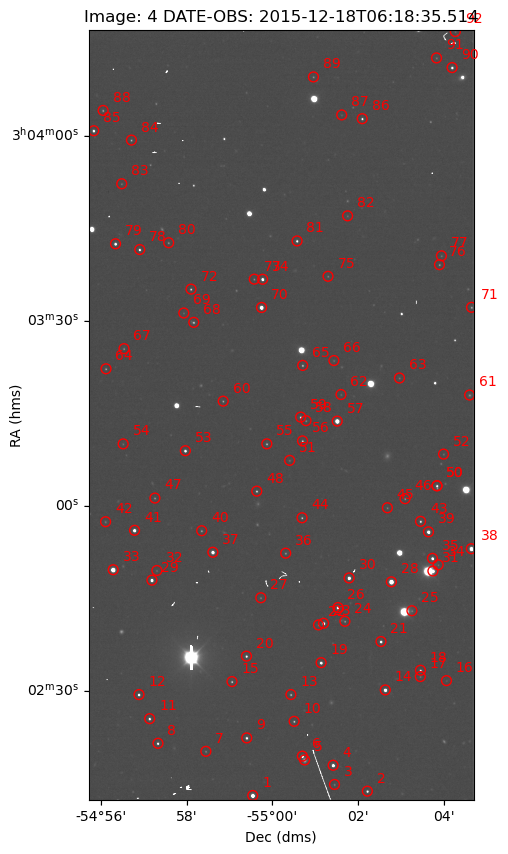

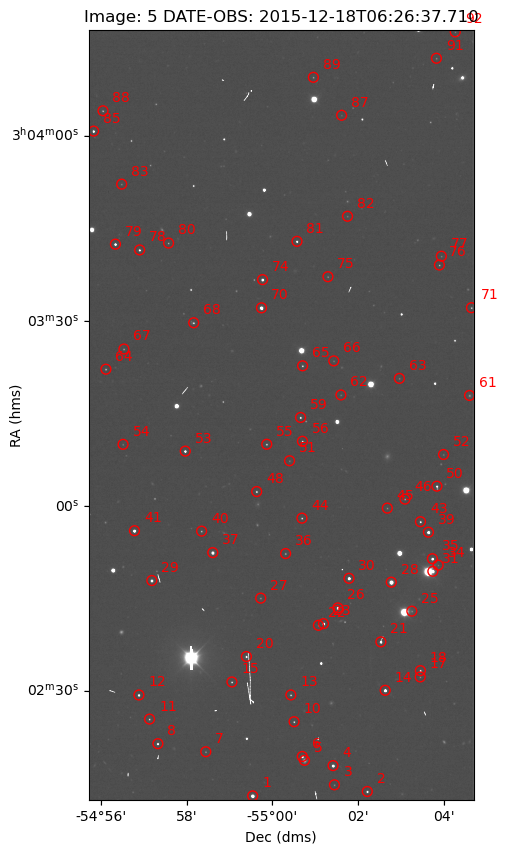

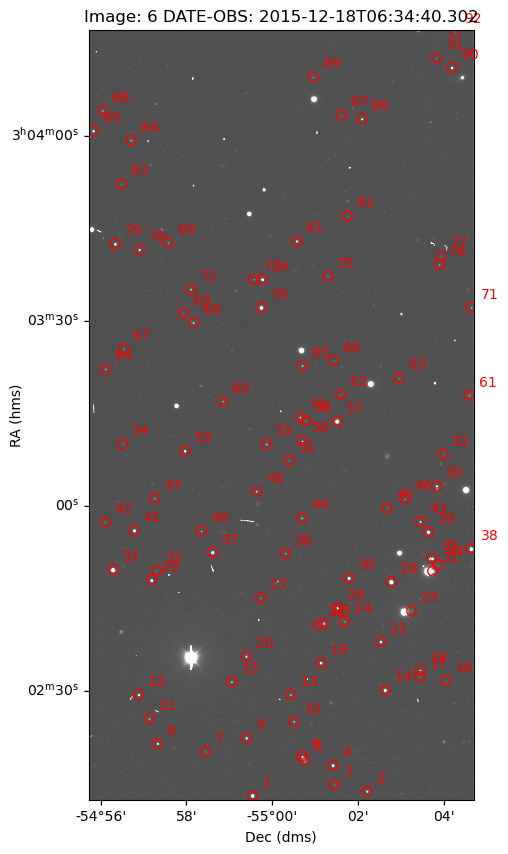

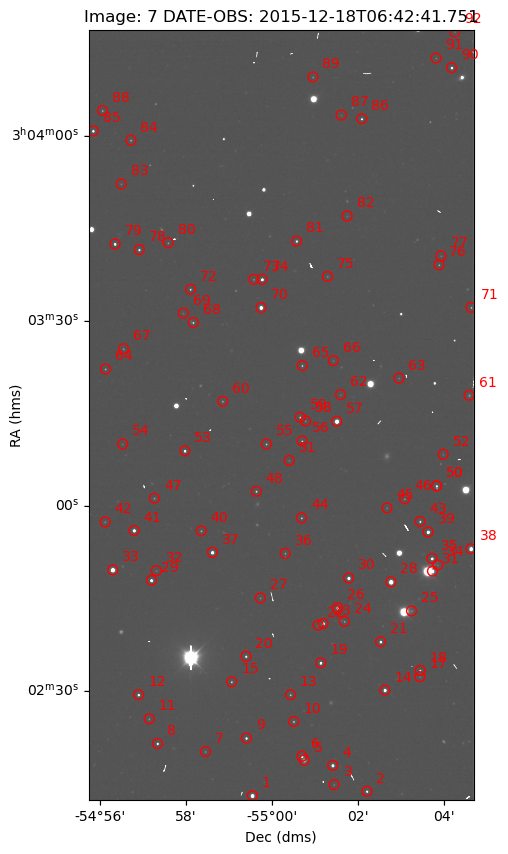

In [29]:
for c, imname in enumerate(imnames_timeordered[start:end:10]):#start+10]):
    data = fits.getdata('dwfflare/dwfflareS18/' + imname)
    header = fits.getheader('dwfflare/dwfflareS18/' + imname)
    wcs = WCS(header)
    time = Time(header['DATE-OBS'])

    fig, ax = plt.subplots(figsize=(20,10), subplot_kw={'projection': wcs})
    ax.imshow(data, clim=(0,100), cmap='Greys_r')
    #ax.scatter(flare_ref_pos[0], flare_ref_pos[1], marker='s', s=200, edgecolors='white', facecolors='None')
    ax.scatter(main_df['x_fit'][main_df['time'] == time.mjd], main_df['y_fit'][main_df['time'] == time.mjd], facecolor='None', edgecolor='red', s=50)

    for i, row in main_df[main_df['time'] == time.mjd].iterrows():
        ax.annotate('{0}'.format(int(row['id'])), xy=row[['x_fit', 'y_fit']], xytext=row[['x_fit', 'y_fit']]+50, color='red')

    ax.set_title('Image: {0} DATE-OBS: {1}'.format(c, time))

    lon, lat = ax.coords
    lon.set_ticks()
    lon.set_ticks_position('lb')
    lon.set_ticklabel_position('lb')
    lon.set_axislabel('Dec (dms)')
    lat.set_ticks()
    lat.set_ticks_position('lb')
    lat.set_ticklabel_position('lb')
    lat.set_axislabel('RA (hms)', minpad=-0.4)

    plt.show()

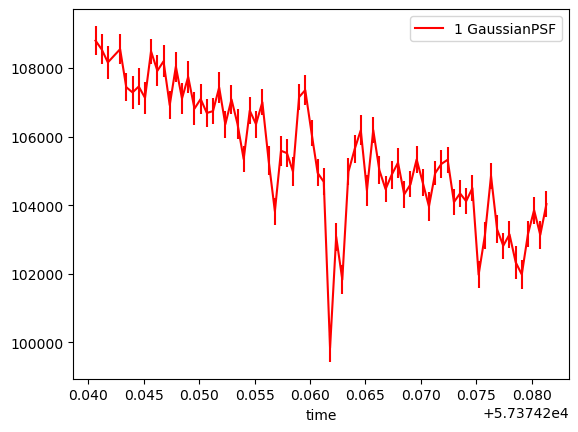

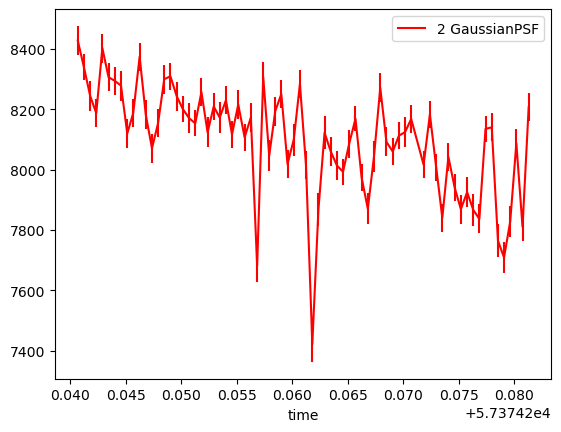

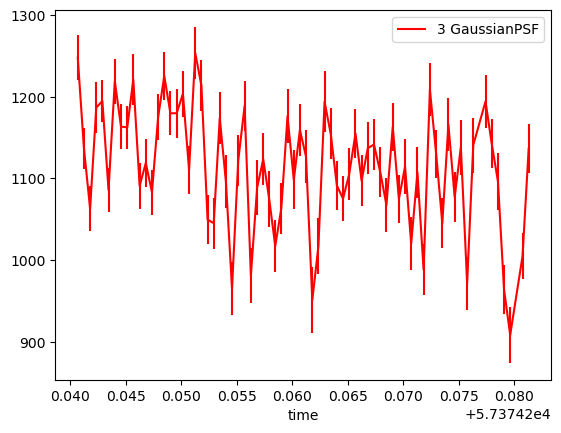

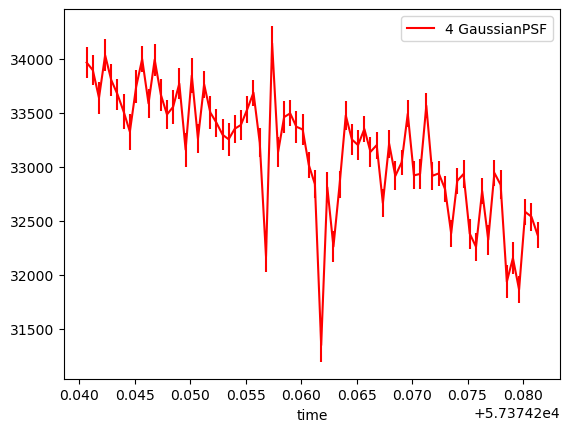

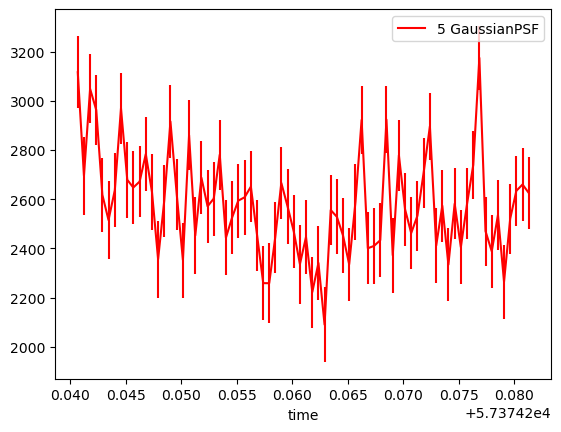

...

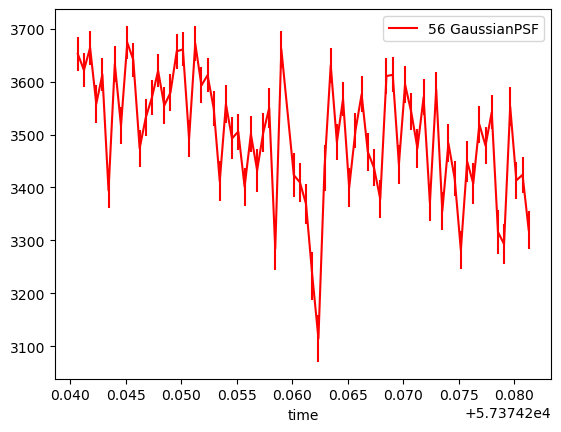

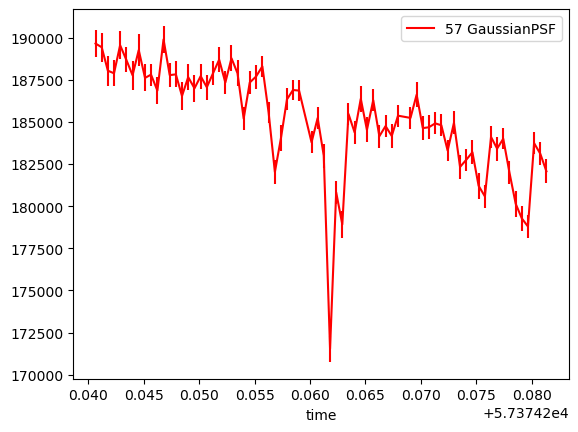

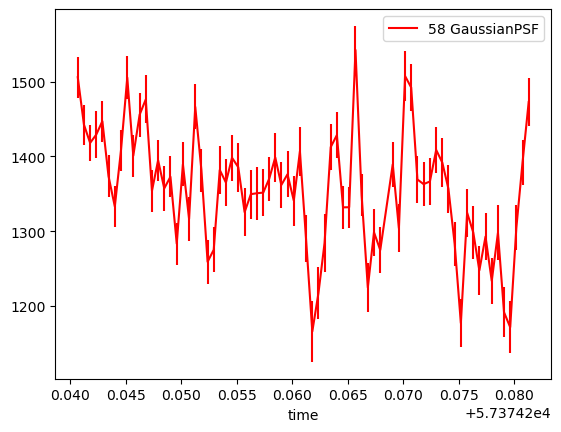

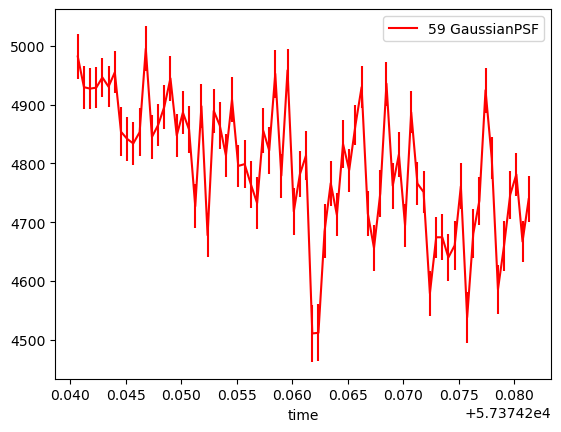

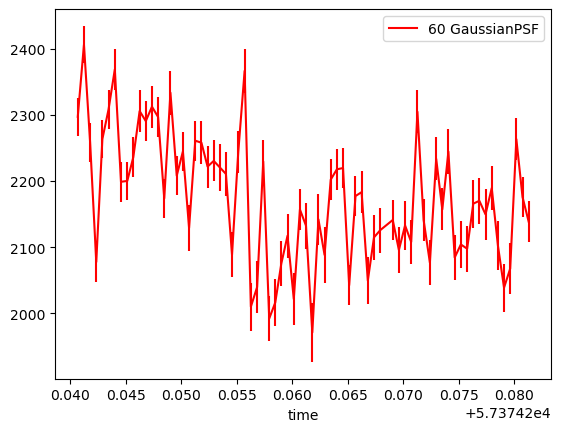

In [30]:
for i in range(60):
    main_df_Gaussian[main_df_Gaussian['id'] == i+1].plot(x = 'time', y='flux_fit', 
                                                       yerr='flux_err', label=f"{i+1} GaussianPSF", color='r')

In [31]:
flr_id = 11

In [32]:
print(f"time stamps with detected flare star {(main_df['id'] == flr_id).sum()}")

time stamps with detected flare star 74


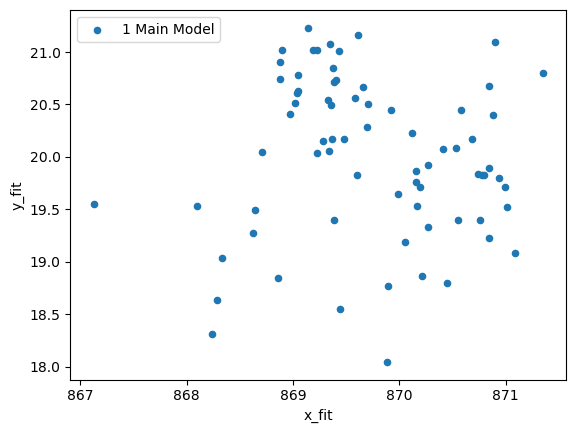

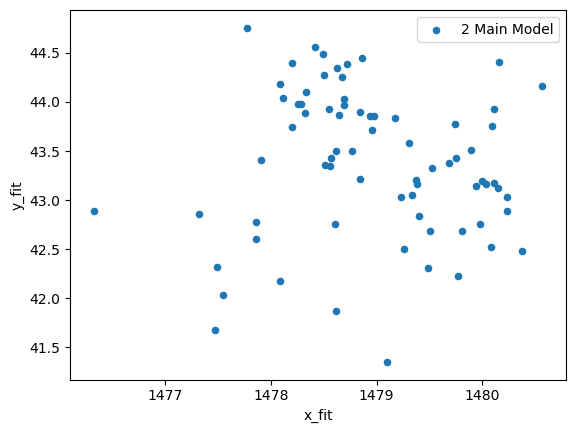

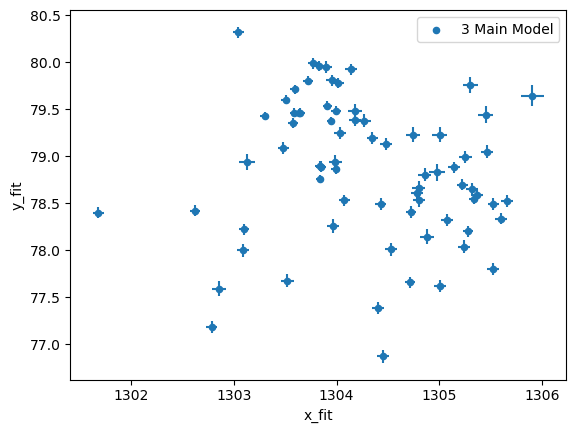

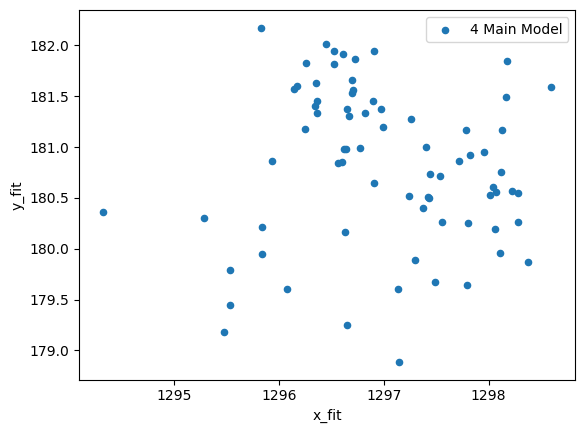

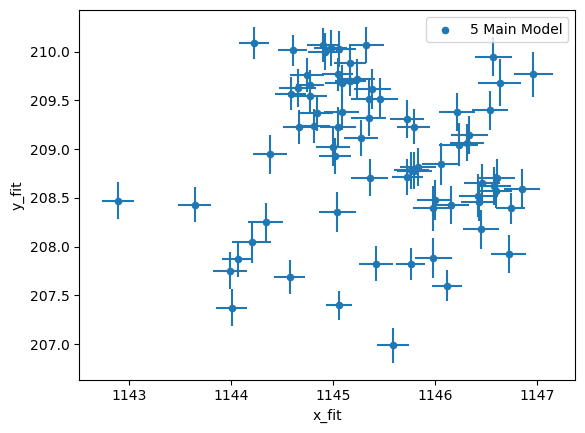

...

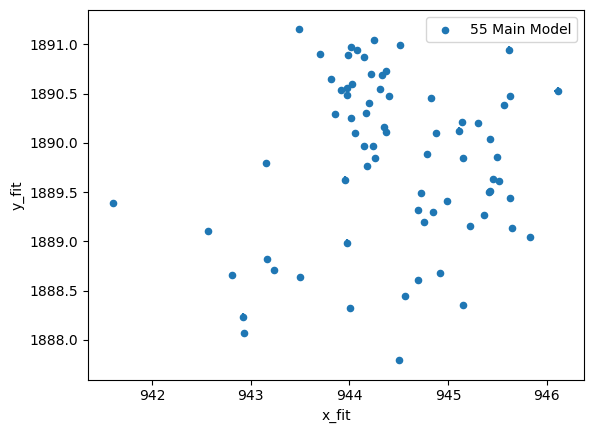

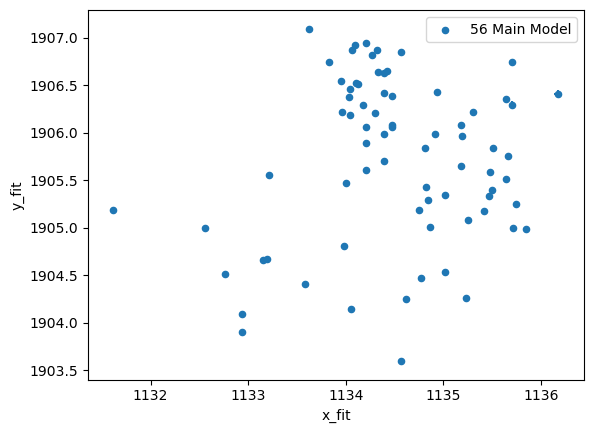

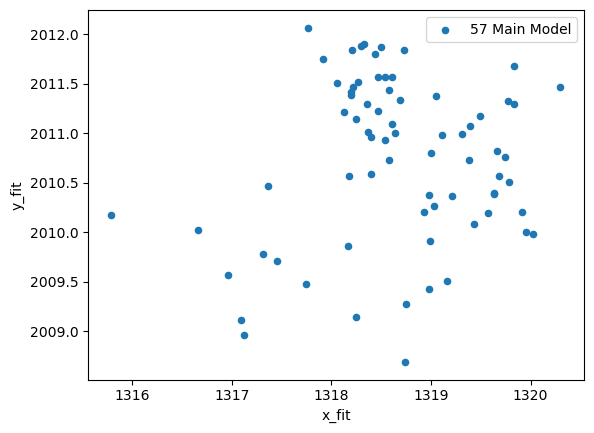

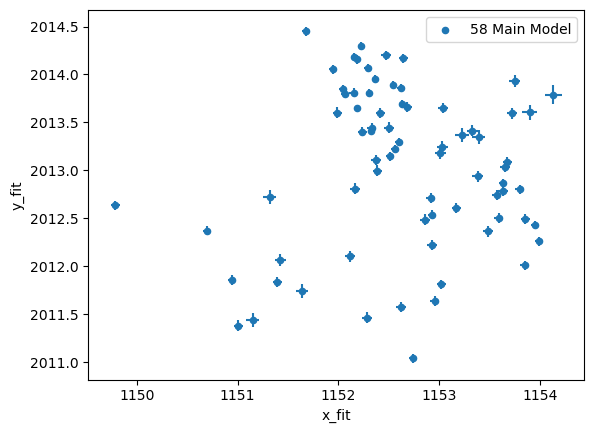

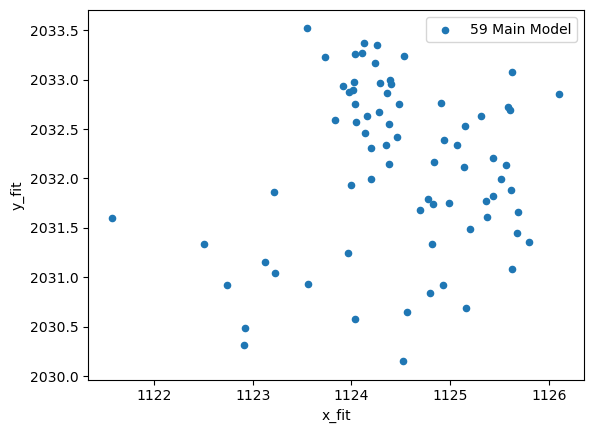

In [33]:
for i in range(1, 60):
    ax = main_df[main_df['id'] == i].plot(x = 'x_fit', y='y_fit', xerr='x_err', yerr='y_err', 
                                          label=f"{i} Main Model", kind='scatter')


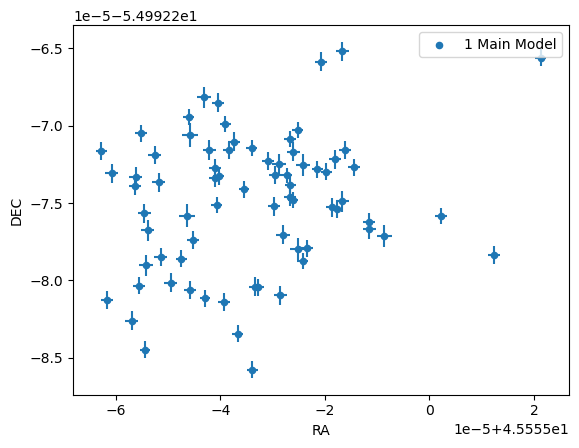

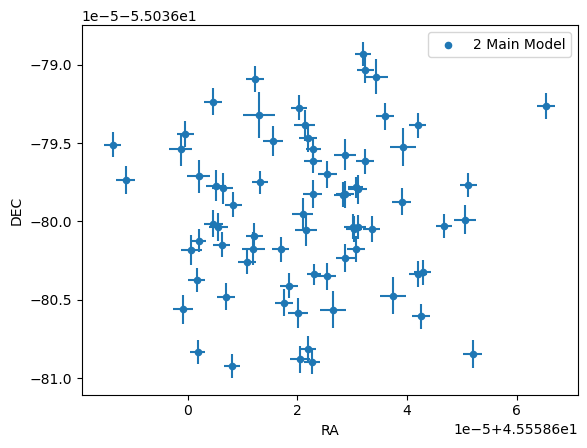

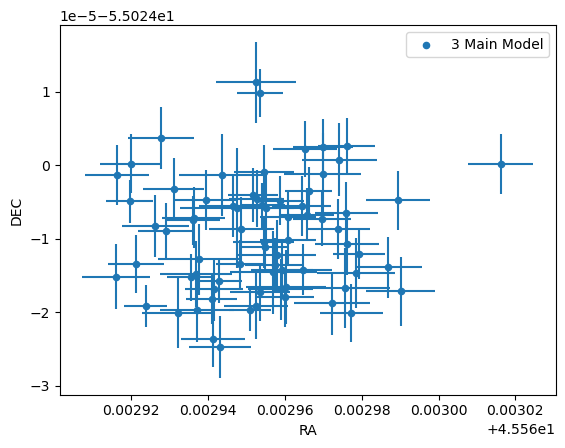

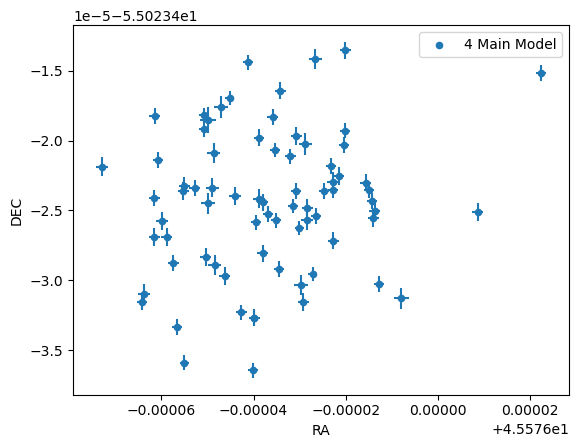

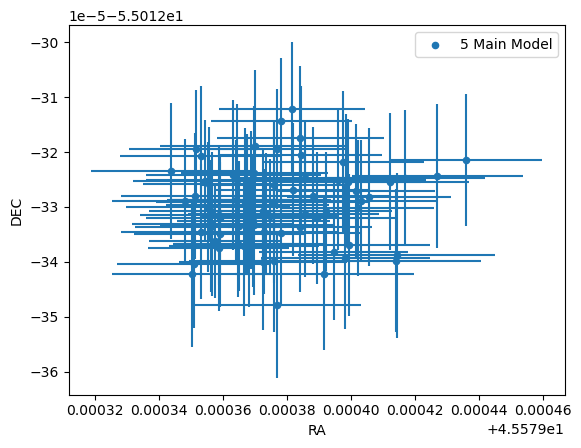

...

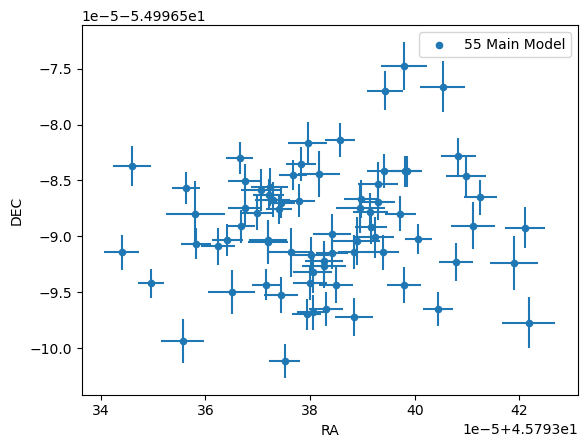

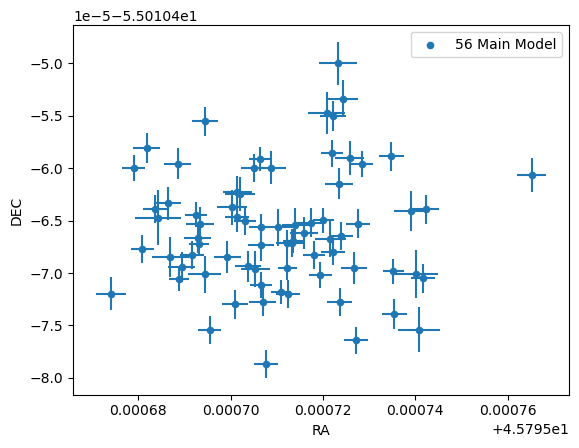

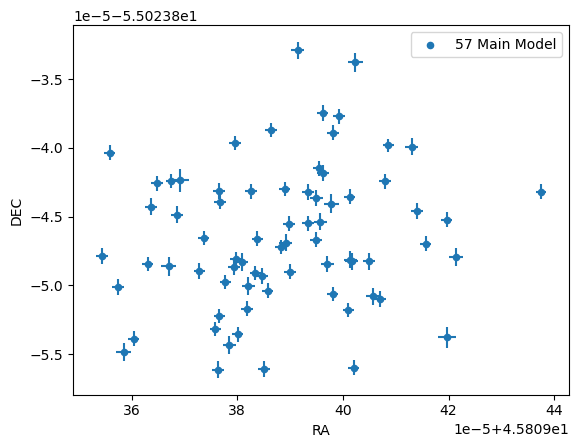

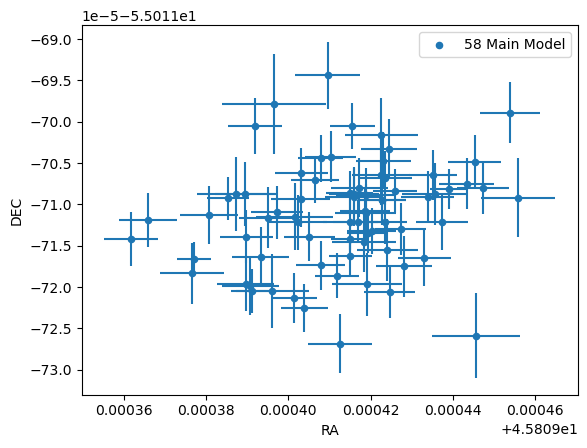

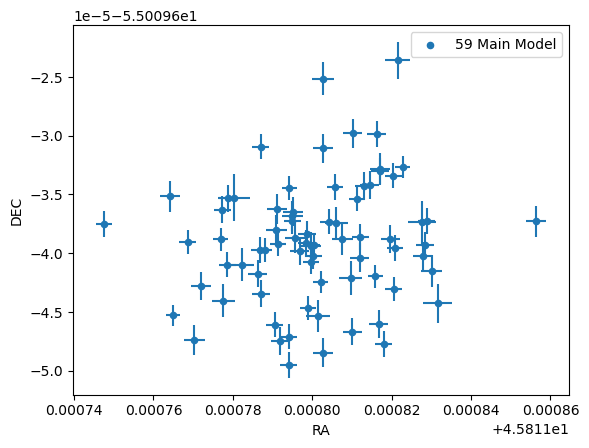

In [34]:
for i in range(1, 60):
    ax = main_df[main_df['id'] == i].plot(x = 'RA', y='DEC', xerr='RA_ERR', yerr='DEC_ERR', 
                                          label=f"{i} Main Model", kind='scatter')

In [35]:
#this makes the timeline of the flare 
t_index = [] # dropping nan time? why??

for i , time in enumerate(main_df['time'].dropna().unique()):

    if (main_df['time'][main_df['id'] == flr_id].values == time).any():
        t_index.append(True)

    else:
        t_index.append(False) 
len(t_index)

74

In [36]:
#put fluxes and turining them into magnitudes - with errors
g_flux = main_df[main_df['id'] == flr_id]['flux_fit']
g_flux_err = main_df[main_df['id'] == flr_id]['flux_err']
flr_times = main_df[main_df['id'] == flr_id]['time']
g_mag = 22.5 - 2.5 * np.log10(g_flux.values)
g_mag_err = (2.5/np.log(10)) * (g_flux_err/g_flux)
g_mag_err = g_mag_err.values #makes it a numpy array?
delta_g_mag = g_mag - np.mean(g_mag[((flr_times - flr_times.iloc[0]) * 3600 * 24) < 1000])
# FBB WHAT IS THE NEXT LINE???
delta_g_mag_err = g_mag_err# - np.sqrt(np.sum(g_mag_err[((flr_times - flr_times.iloc[0]) * 3600 * 24) < 1000] ** 2)) /  len(g_mag_err[((flr_times - flr_times.iloc[0]) * 3600 * 24) < 1000]) 



for i, t in enumerate(t_index):
    #print(t)
    if not t:
        delta_g_mag = np.insert(delta_g_mag, i, np.nan)
        delta_g_mag_err = np.insert(delta_g_mag_err, i, np.nan)
        flr_times = np.insert(flr_times, i, np.nan)
    else:
        pass

Text(0.5, 0, 'MJD')

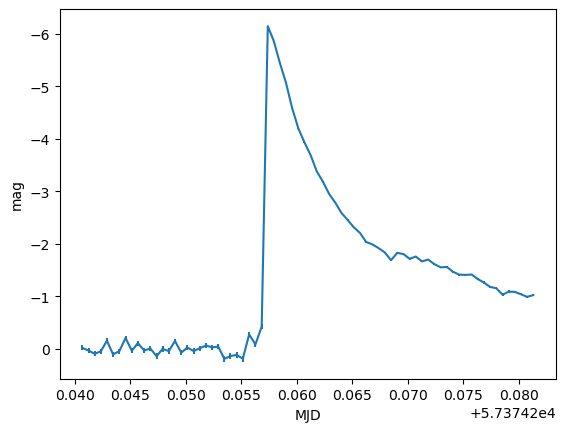

In [37]:
plt.errorbar(#range(len(delta_g_mag)),
    #(np.array(times_restrictes) - times_restrictes[0]) * 3600 * 24, 
    flr_times,
    delta_g_mag, yerr=delta_g_mag_err)
    #yerr=g_mag_err)
plt.gca().invert_yaxis()
plt.ylabel("mag")
plt.xlabel("MJD")

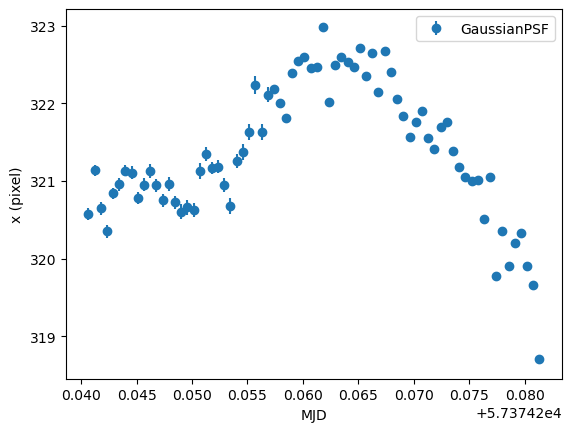

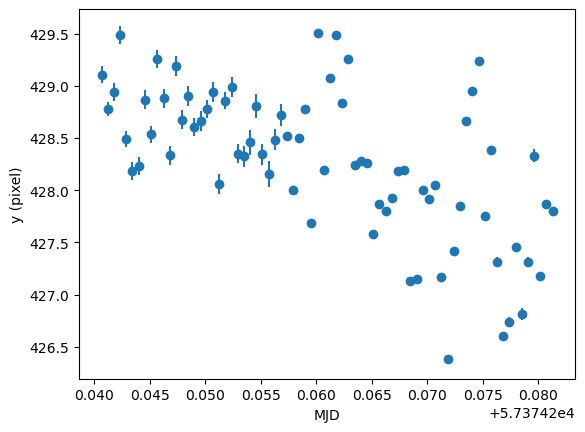

In [38]:
plt.errorbar(main_df_Gaussian['time'][main_df_Gaussian['id'] == flr_id], 
             main_df_Gaussian['x_fit'][main_df_Gaussian['id'] == flr_id], 
             yerr = main_df_Gaussian['x_err'][main_df_Gaussian['id'] == flr_id], marker='o', ls='None', label="GaussianPSF")
plt.ylabel('x (pixel)')
plt.legend()
plt.xlabel("MJD")
plt.show()
plt.errorbar(main_df_Gaussian['time'][main_df_Gaussian['id'] == flr_id], 
             main_df_Gaussian['y_fit'][main_df_Gaussian['id'] == flr_id], 
             yerr = main_df_Gaussian['y_err'][main_df_Gaussian['id'] == flr_id], marker='o', ls='None', label="GaussianPSF")
plt.ylabel('y (pixel)')
plt.xlabel("MJD")
plt.show()


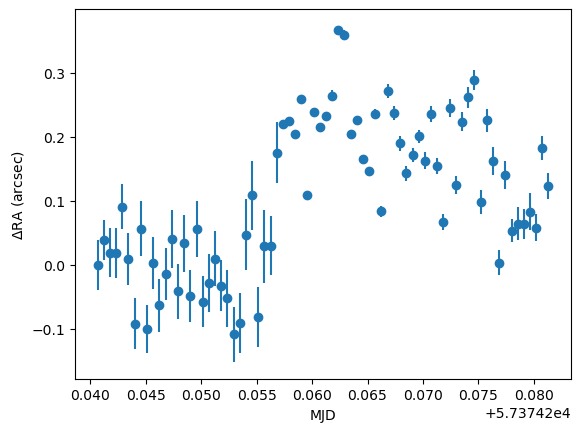

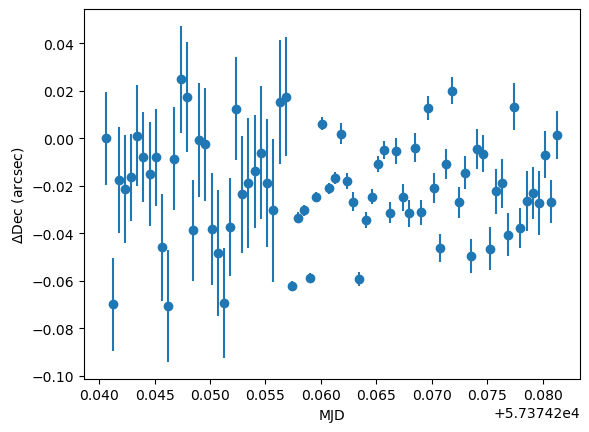

In [39]:

plt.errorbar(main_df['time'][main_df['id'] == flr_id], (main_df['RA'][main_df['id'] == flr_id] - main_df['RA'][main_df['id'] == flr_id].iloc[0]) * 3600, yerr = main_df['RA_ERR'][main_df['id'] == flr_id] * 3600, marker='o', ls='None')
plt.ylabel(r'$\Delta$RA (arcsec)')
plt.xlabel("MJD")
plt.show()

plt.errorbar(main_df['time'][main_df['id'] == flr_id], (main_df['DEC'][main_df['id'] == flr_id] - main_df['DEC'][main_df['id'] == flr_id].iloc[0]) * 3600, yerr = main_df['DEC_ERR'][main_df['id'] == flr_id] * 3600, marker='o', ls='None')
plt.ylabel(r'$\Delta$Dec (arcsec)')
plt.xlabel("MJD")
plt.show()